In [1]:
import itertools
import sys, os

import numpy as np
import pandas as pd
from scipy.special import comb
from scipy import stats
import scipy.cluster.hierarchy as hac
import matplotlib.pyplot as plt
plt.style.use('classic')
%matplotlib inline
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
import statsmodels.api as sm

sns.set(rc={'figure.figsize':(15,8)})
sns.set_context('poster')
from sklearn.model_selection import train_test_split

In [2]:
%load_ext autoreload
%autoreload 2
import CCPA_lib as cp


In [3]:
sns.set_context('poster')
sns.set_style('white')

In [4]:

ppallete = 'RdYlGn'#'YlGn_d' #"BuGn_d"
porder = ['MED4',  'MIT9312','MIT0604', 'Natl2A', 'MIT9313']
ppallete = [ '#62A586', '#face6e','#f79934', '#7A9BC8', '#F47681', ]
psizes = [150,120,200,120,350]
pmarkers = ['o', 's', '^', 'D', '*']

# #ffd7a1
    
pedge = 'green'
apallete = "spring"
aorder = ['DE', 'DE1', '1A3', 'ATCC', 'BS11']
amarkers = ['P', 'X', 'h', '<','>']
apallete = ['#6dad36', '#c7e89f', '#f5c4e1', '#d5579d', '#8a0850']

aedge='orange'
epallete = ['#6cf0ba', '#d13f75', '#eeb7cb', '#b9d2d8', '#407f90']
#sns.diverging_palette(355, 217, s=74, l=50, n=4) #'Paired' # 'BrBG'# "coolwarm"
eorder = ['e1','e3', 'e4', 'e5', 'e6']
#aedge='orange'


In [5]:
df = pd.read_pickle('CCPA.pkl.gz')
df.loc[df.PRO == 'C9B', 'PRO'] = 'MIT0604'

In [6]:
dfw = df.loc[(df.experiment.isin(['e1', 'e3', 'e4','e5', 'e6']))]

In [7]:
#dfw = df.loc[(df.experiment.isin(['e1','e3', 'e4','e5', 'e6'])) # & (df.culture == 'Co_Culture')
#            ]

In [8]:
dfdecline = cp.generate_decline(dfw, scale=False)
#dfdecline = dfdecline.loc[dfdecline['day'] <= 80]

In [9]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture


In [10]:
for n, f in [
    ('exponential', cp.model_exponential1),
    #('hyperbolic', cp.model_hyperbolic),
    ('harmonic', cp.model_harmonic),
]:
    #f = cp.model_exponential
    t = dfdecline.groupby('experiment_sample').apply(lambda x: cp.apply_fit1(x, f, print_popt=False))
    dfdecline[n] = t['y_pred']
    for i in range(3):
        dfdecline[f'{n}_popt_{i}'] = t[f'popt_{i}']
#dfdecline['decline'] = dfdecline.FL
#dfdecline['exponential_diff'] = dfdecline.FL - dfdecline.exponential
#dfdecline['decline_scaled'] = dfdecline.groupby('experiment_sample').FL.transform(lambda x: x / x.max())
#df_exp_coef = dfdecline.groupby(['experiment_sample','popt_0', 'popt_1', 'popt_2'])['decline'].count().reset_index(level=[1,2,3])\
#.drop(columns='decline')

In [11]:
dfdecline.columns

Index(['experiment_sample', 'day', 'FL', 'experiment', 'sample', 'PRO', 'ALT',
       'culture', 'exponential', 'exponential_popt_0', 'exponential_popt_1',
       'exponential_popt_2', 'harmonic', 'harmonic_popt_0', 'harmonic_popt_1',
       'harmonic_popt_2'],
      dtype='object')

In [12]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture,exponential,exponential_popt_0,exponential_popt_1,exponential_popt_2,harmonic,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture,5.621000,0.141021,1.0,1.0,5.621000,0.296513,0.5,0.5
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture,4.955857,0.141021,1.0,1.0,4.444171,0.296513,0.5,0.5
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture,4.244581,0.141021,1.0,1.0,3.533985,0.296513,0.5,0.5
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture,2.898240,0.141021,1.0,1.0,2.349141,0.296513,0.5,0.5
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture,2.516052,0.141021,1.0,1.0,2.089493,0.296513,0.5,0.5


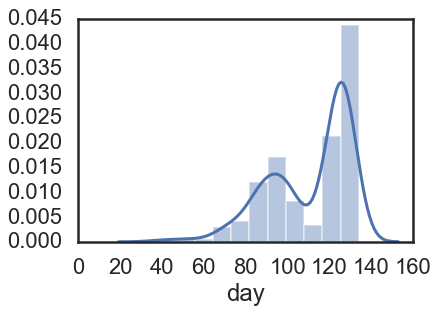

In [13]:
sns.distplot(dfdecline.groupby('experiment_sample')['day'].max()) #.sort_values()

In [14]:
def _compute_score_model(x,m):
    res = {f'{m}_popt_{i}' : x[f'{m}_popt_{i}'].unique()[0] for i in range(3)}
    if np.isnan(res[f'{m}_popt_0']):
        res.update({
            f'rmse_{m}' : np.NaN,
            f'rmse_{m}_60' : np.NaN,
            f'rmse_{m}_5' : np.NaN,
            f'bic_{m}' : np.NaN,
        })
    else:
        x60 = x.loc[x.day >= 60]
        x5 = x.loc[x.day <= 5]
        n = x.shape[0]
        num_params = 3 if m == 'hyperbolic' else 2
        res.update({
            f'rmse_{m}' : np.sqrt(metrics.mean_squared_error(x['FL'], x[m])),
            f'rmse_{m}_60' : np.sqrt(metrics.mean_squared_error(x60['FL'], x60[m])) if x60.shape[0]>2 else np.NaN,
            f'rmse_{m}_5' : np.sqrt(metrics.mean_squared_error(x5['FL'], x5[m])),
            f'bic_{m}' : n * np.log(metrics.mean_squared_error(x['FL'], x[m])) + num_params * np.log(n),
        })
    return res

def _compute_r2(x):
    models = ['exponential', #'hyperbolic',
              'harmonic', ]
    res_list = [_compute_score_model(x,m) for m in models]
    res =dict()
    for i in res_list:
        res.update(i)
    return pd.Series(res)
groupcols = ['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture', ]
dfscore = dfdecline.groupby(groupcols).apply(_compute_r2).reset_index()

In [15]:
dfscore.head()

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,rmse_exponential_60,rmse_exponential_5,bic_exponential,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2,rmse_harmonic,rmse_harmonic_60,rmse_harmonic_5,bic_harmonic
0,"e1, 10A",e1,10A,MIT0604,DE,Co_Culture,0.141021,1.0,1.0,0.464884,0.380375,0.875655,-112.284026,0.296513,0.5,0.5,0.258618,0.171010,0.525833,-204.940841
1,"e1, 10B",e1,10B,MIT0604,DE,Co_Culture,0.142509,0.5,0.5,0.502003,0.427945,0.716883,-100.146790,0.251377,1.0,1.0,0.292172,0.182514,0.426032,-185.666056
2,"e1, 10C",e1,10C,MIT0604,DE,Co_Culture,0.164214,0.5,0.5,0.438341,0.377199,0.638036,-121.572837,0.339183,0.5,0.5,0.242214,0.191506,0.322598,-215.294304
3,"e1, 11A",e1,11A,MED4,DE1,Co_Culture,0.101841,1.0,1.0,0.390940,0.258564,0.522128,-141.508043,0.281051,0.5,0.5,0.290267,0.109511,1.074854,-189.148614
4,"e1, 11B",e1,11B,MED4,DE1,Co_Culture,0.125338,1.0,1.0,0.433475,0.271690,0.884889,-123.336604,0.352388,0.5,0.5,0.174111,0.098071,0.398180,-267.454893


In [16]:
dfscore.to_pickle('exponential_decline.pkl.gz')

In [17]:
dfscorem = dfscore.melt(id_vars=['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture'],
                        value_vars=['rmse_exponential', #'rmse_hyperbolic', 
                                    'rmse_harmonic', 
                                    'rmse_exponential_60', #'rmse_hyperbolic_60', 
                                    'rmse_harmonic_60',
                                    'rmse_exponential_5', #'rmse_hyperbolic_5',
                                    'rmse_harmonic_5',
                                    'bic_exponential', #'bic_hyperbolic', 
                                    'bic_harmonic'
                                    
                                   ], 
                        value_name='RMSE',
                        var_name='model')


In [18]:
dfscorem['s'] = dfscorem['sample'] +', '+ dfscorem.ALT
dfscorem['e'] = dfscorem['experiment'] +', '+ dfscorem.culture
dfscorem['p'] = dfscorem['PRO'] 
dfscorem.loc[dfscorem.culture == 'Axenic', 'p'] =dfscorem.loc[dfscorem.culture == 'Axenic', 'p']+ ' Axenic'



Text(0.5,1,'root mean square error per model')

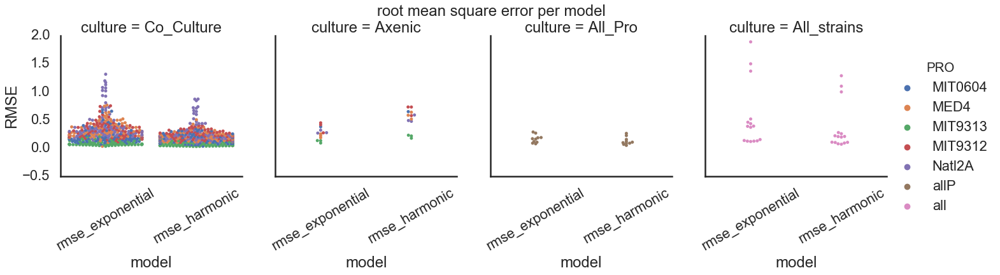

In [19]:
cols=['rmse_exponential',# 'rmse_hyperbolic', 
      'rmse_harmonic', 
      #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60',
      #'mse_exponential_5', 'mse_hyperbolic_5', 'mse_harmonic_5'
] 

g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols)], x='model', y='RMSE', hue='PRO', kind='swarm', #aspect=2,
           #palette='cubehelix'
            col='culture',
           )
g.set_xticklabels(rotation=30)
#plt.xticks(rotation=45)
plt.suptitle('root mean square error per model', y=1)

C:\Users\wosnat\Anaconda3\lib\site-packages\numpy\core\_methods.py:217: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\wosnat\Anaconda3\lib\site-packages\numpy\core\_methods.py:209: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Text(0.5,1,'RMSE co-culture')

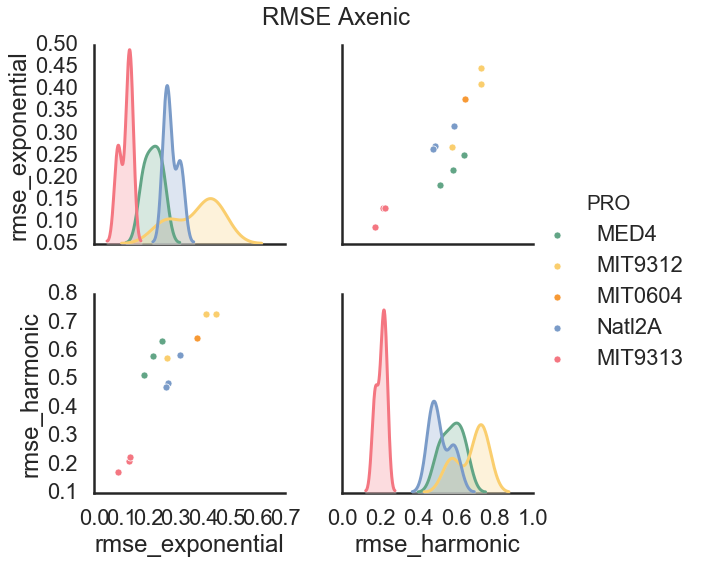

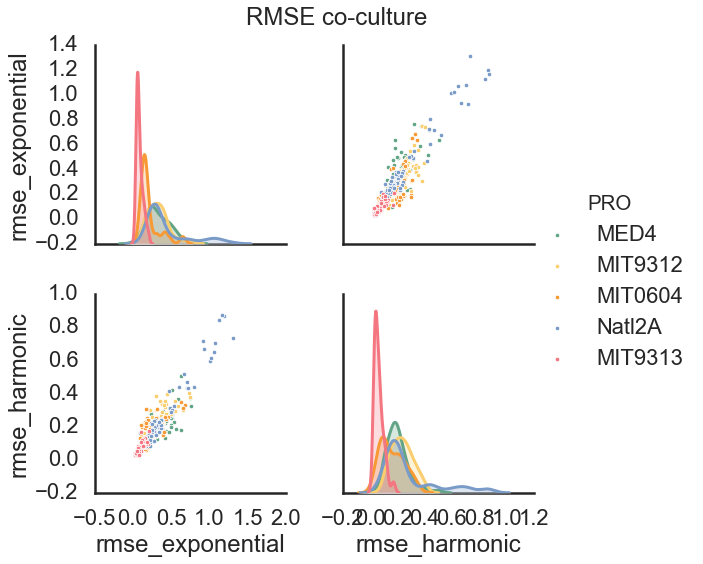

In [20]:
sns.pairplot(dfscore.loc[dfscore.culture == 'Axenic'], 
             vars=['rmse_exponential', #'rmse_hyperbolic', 
                   'rmse_harmonic',
                            #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60'
                            #'rmse_exponential_5', 'rmse_hyperbolic_5', 'rmse_harmonic_5',
                           ],
             height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             plot_kws={"s": 50},
             #kind='reg'
            )
plt.suptitle('RMSE Axenic', y=1)
sns.pairplot(dfscore.loc[dfscore.culture == 'Co_Culture'], 
             vars=['rmse_exponential', #'rmse_hyperbolic',
                   'rmse_harmonic',
                            #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60'
                            #'rmse_exponential_5', 'rmse_hyperbolic_5', 'rmse_harmonic_5',
                           ],
             height=4, 
             plot_kws={"s": 20},
             hue='PRO', hue_order=porder, palette=ppallete,
             #kind='reg'
            )
plt.suptitle('RMSE co-culture', y=1)


Text(0.5,1,'RMSE co-culture')

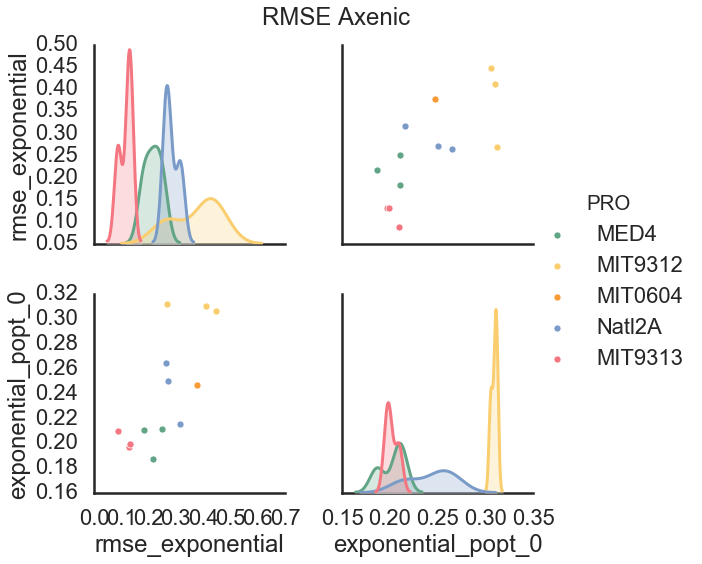

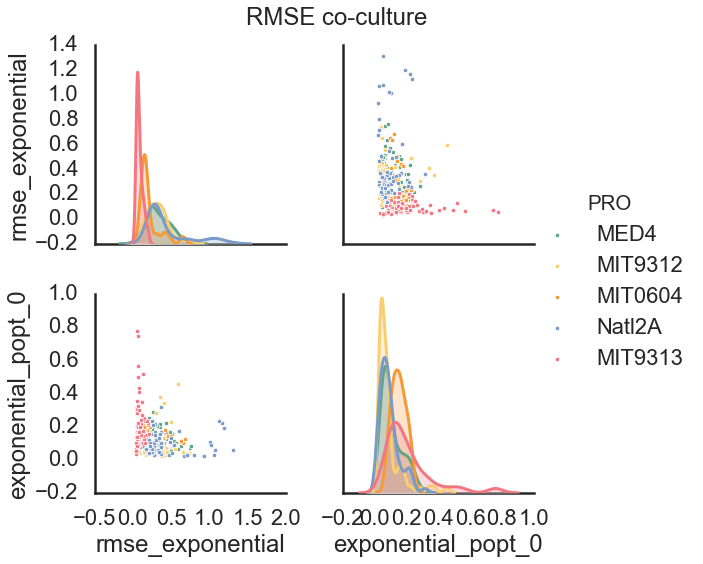

In [21]:
sns.pairplot(dfscore.loc[dfscore.culture == 'Axenic'], 
             vars=['rmse_exponential', #'rmse_hyperbolic', 
                   'exponential_popt_0',
                            #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60'
                            #'rmse_exponential_5', 'rmse_hyperbolic_5', 'rmse_harmonic_5',
                           ],
             height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             plot_kws={"s": 50},
             #kind='reg'
            )
plt.suptitle('RMSE Axenic', y=1)
sns.pairplot(dfscore.loc[dfscore.culture == 'Co_Culture'], 
             vars=['rmse_exponential', #'rmse_hyperbolic',
                   'exponential_popt_0',
                            #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60'
                            #'rmse_exponential_5', 'rmse_hyperbolic_5', 'rmse_harmonic_5',
                           ],
             height=4, 
             plot_kws={"s": 20},
             hue='PRO', hue_order=porder, palette=ppallete,
             #kind='reg'
            )
plt.suptitle('RMSE co-culture', y=1)


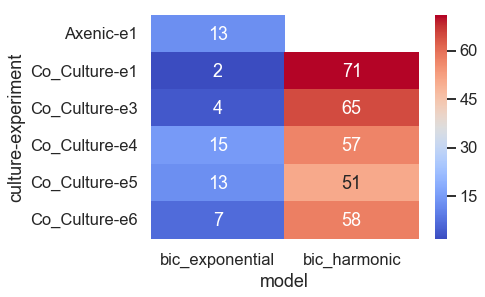

In [22]:
best_model_df = dfscorem.loc[dfscorem.model.isin(['bic_exponential', 'bic_harmonic'])
                            ].sort_values('RMSE', ascending=True).drop_duplicates([
    'experiment_sample', ])
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(index=['culture',  'experiment'],columns=['model'], values='sample', aggfunc='count')
sns.set_context('talk')
sns.heatmap(t, annot=True, cmap='coolwarm')


Text(0.5,1,'best model (lowest bic)')

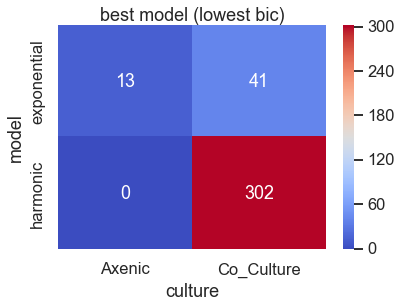

In [23]:
best_model_df = dfscorem.loc[dfscorem.model.isin(['bic_exponential', 'bic_harmonic'])
                            ].sort_values('RMSE', ascending=True).drop_duplicates([
    'experiment_sample', ])
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(index=['culture'],columns=['model'], values='sample', aggfunc='count')
t.rename(columns={'bic_exponential': 'exponential', 'bic_harmonic': 'harmonic'}, inplace=True)
t.fillna(0, inplace=True)
for i in t.columns:
    t[i] = t[i].astype(int)
sns.set_context('talk')
sns.heatmap(t.T, annot=True, cmap='coolwarm', fmt='d')
plt.title('best model (lowest bic)')

Text(0.5,1,'best model fit')

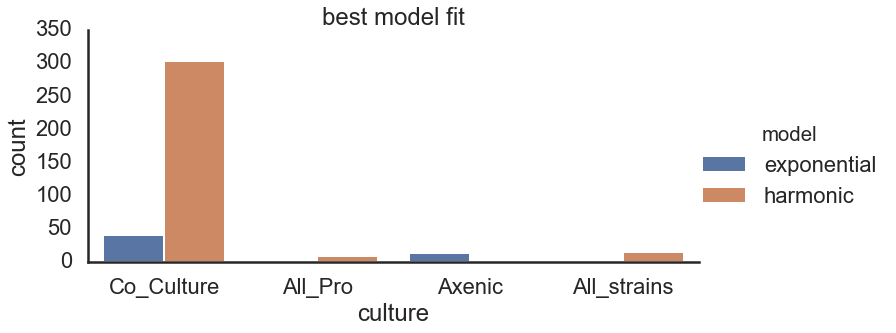

In [24]:
sns.set_context('poster')
best_model_df = dfscorem.loc[dfscorem.model.isin(['bic_exponential', 'bic_harmonic'])
                            ].sort_values('RMSE', ascending=True).drop_duplicates([
    'experiment_sample', ])
best_model_df.model = best_model_df.model.map({'bic_exponential': 'exponential', 'bic_harmonic': 'harmonic'})
sns.catplot(data=best_model_df, x='culture', hue='model', kind='count', aspect=2, 
            hue_order=['exponential', 'harmonic'])
plt.title("best model fit")

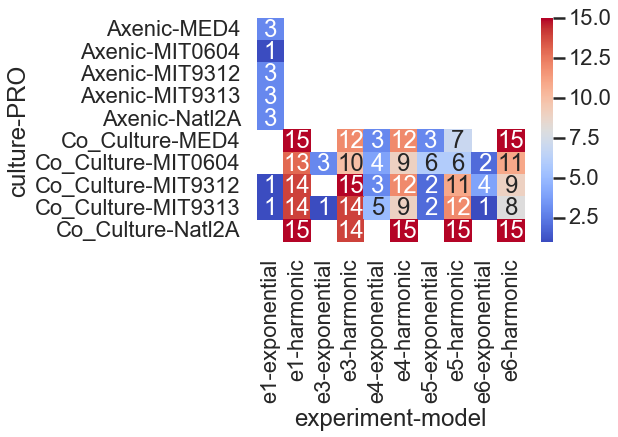

In [25]:
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(index=['culture',  'PRO', ],columns=['experiment', 'model', ], values='sample', aggfunc='count')
#sns.set_context('talk')
sns.heatmap(t, annot=True, cmap='coolwarm')


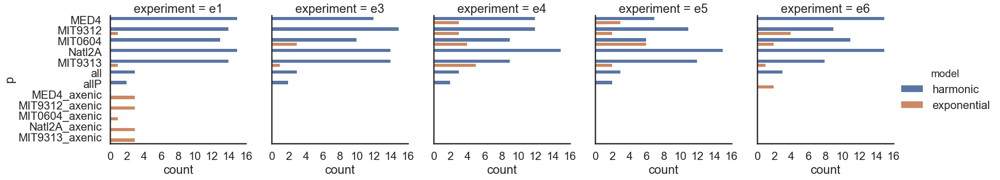

In [26]:
best_model_df['p'] = best_model_df['PRO']
best_model_df.loc[best_model_df.culture == 'Axenic','p'] = best_model_df.loc[best_model_df.culture == 'Axenic','p'] + '_axenic'
sns.catplot(data=best_model_df, y='p', hue='model', kind='count', col='experiment',
           order=['MED4', 'MIT9312', 'MIT0604', 'Natl2A', 'MIT9313', 'all', 'allP',
                     'MED4_axenic', 'MIT9312_axenic', 'MIT0604_axenic', 'Natl2A_axenic', 'MIT9313_axenic'
                     ],
            col_order=eorder,
           )


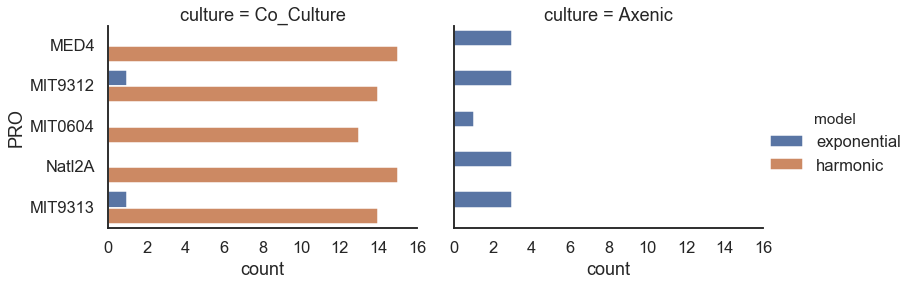

In [27]:
sns.set_context('talk')
#best_model_df['p'] = best_model_df['PRO']
#best_model_df.loc[best_model_df.culture == 'Axenic','p'] = best_model_df.loc[best_model_df.culture == 'Axenic','p'] + '_axenic'
sns.catplot(data=best_model_df.loc[(best_model_df.experiment == 'e1') & 
                                   (best_model_df.culture.isin(['Co_Culture', 'Axenic']))],
            y='PRO', hue='model', kind='count', col='culture',
           order=porder,
            col_order=['Co_Culture', 'Axenic'],
            aspect=1.4, height=4
            #col_order=eorder,
           )


In [28]:
best_model_df.p.unique()

array(['MIT9313', 'allP', 'MIT0604', 'MIT9313_axenic', 'all', 'MIT9312',
       'MED4', 'Natl2A', 'MED4_axenic', 'Natl2A_axenic', 'MIT9312_axenic',
       'MIT0604_axenic'], dtype=object)

In [29]:
porder

['MED4', 'MIT9312', 'MIT0604', 'Natl2A', 'MIT9313']

In [30]:
best_model_df.head()

,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
2765,"e3, 12B",e3,12B,MIT9313,DE1,Co_Culture,harmonic,-473.582112,"12B, DE1","e3, Co_Culture",MIT9313
2780,"e3, 17C",e3,17C,MIT9313,BS11,Co_Culture,harmonic,-467.243838,"17C, BS11","e3, Co_Culture",MIT9313
2778,"e3, 17A",e3,17A,MIT9313,BS11,Co_Culture,harmonic,-450.771978,"17A, BS11","e3, Co_Culture",MIT9313
2825,"e3, 7B",e3,7B,MIT9313,DE,Co_Culture,harmonic,-449.651791,"7B, DE","e3, Co_Culture",MIT9313
2872,"e4, 22B",e4,22B,MIT9313,ATCC,Co_Culture,harmonic,-447.548600,"22B, ATCC","e4, Co_Culture",MIT9313


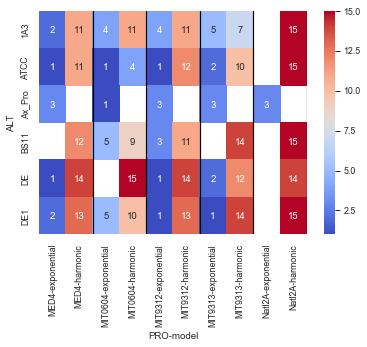

In [31]:

t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])
                     ].pivot_table(index=['ALT'], columns=['PRO','model', ], values='sample', aggfunc='count')
sns.set_context('paper')
sns.heatmap(t, annot=True, cmap='coolwarm' )
for i in [2,4,6,8,10]:
    plt.axvline(i, color='black',)


In [32]:
best_model_df['model'].value_counts()


harmonic       325
exponential     56
Name: model, dtype: int64

In [33]:
best_model_df.head()


,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
2765,"e3, 12B",e3,12B,MIT9313,DE1,Co_Culture,harmonic,-473.582112,"12B, DE1","e3, Co_Culture",MIT9313
2780,"e3, 17C",e3,17C,MIT9313,BS11,Co_Culture,harmonic,-467.243838,"17C, BS11","e3, Co_Culture",MIT9313
2778,"e3, 17A",e3,17A,MIT9313,BS11,Co_Culture,harmonic,-450.771978,"17A, BS11","e3, Co_Culture",MIT9313
2825,"e3, 7B",e3,7B,MIT9313,DE,Co_Culture,harmonic,-449.651791,"7B, DE","e3, Co_Culture",MIT9313
2872,"e4, 22B",e4,22B,MIT9313,ATCC,Co_Culture,harmonic,-447.548600,"22B, ATCC","e4, Co_Culture",MIT9313


In [34]:
dfscore.describe()

,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,rmse_exponential_60,rmse_exponential_5,bic_exponential,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2,rmse_harmonic,rmse_harmonic_60,rmse_harmonic_5,bic_harmonic
count,381.000000,381.000000,381.000000,381.000000,373.000000,381.000000,381.000000,381.000000,381.000000,381.000000,381.000000,373.000000,381.000000,381.000000
mean,0.130487,0.738845,0.738845,0.291875,0.175054,0.423349,-164.233254,0.298662,0.750656,0.750656,0.206192,0.109910,0.439923,-205.257675
std,0.097327,0.250079,0.250079,0.236205,0.165209,0.462183,91.227108,0.242124,0.250328,0.250328,0.167540,0.103865,0.505497,92.674483
min,0.019544,0.500000,0.500000,0.029888,0.020403,0.001370,-390.634113,0.041187,0.500000,0.500000,0.026233,0.002040,0.008426,-473.582112
25%,0.062534,0.500000,0.500000,0.142118,0.059211,0.125442,-216.472256,0.156747,0.500000,0.500000,0.101439,0.036880,0.146808,-259.829330
50%,0.104588,0.500000,0.500000,0.237827,0.122545,0.304139,-156.849591,0.236798,1.000000,1.000000,0.176759,0.077781,0.281539,-200.276029
75%,0.174960,1.000000,1.000000,0.368242,0.229596,0.533773,-100.146790,0.370979,1.000000,1.000000,0.248088,0.150757,0.526341,-137.562671
max,0.773035,1.000000,1.000000,1.884844,1.044806,4.183931,101.122262,1.722105,1.000000,1.000000,1.283041,0.696823,3.367423,44.968907


In [35]:
sns.set_context('poster')

In [36]:
dfscore.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'exponential_popt_0', 'exponential_popt_1', 'exponential_popt_2',
       'rmse_exponential', 'rmse_exponential_60', 'rmse_exponential_5',
       'bic_exponential', 'harmonic_popt_0', 'harmonic_popt_1',
       'harmonic_popt_2', 'rmse_harmonic', 'rmse_harmonic_60',
       'rmse_harmonic_5', 'bic_harmonic'],
      dtype='object')

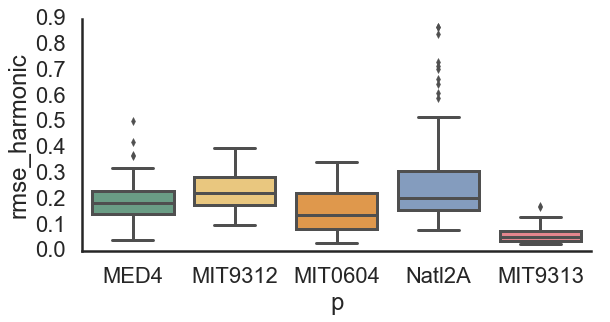

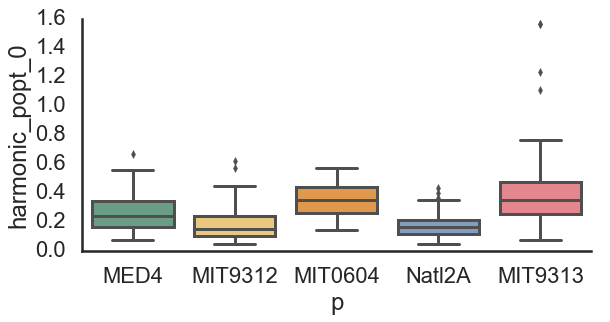

In [37]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture=='Axenic','p'] = dfscore.loc[dfscore.culture=='Axenic','p'] + '_Axenic'

for i in ['rmse_harmonic', 'harmonic_popt_0', ]:
    sns.catplot(data=dfscore.loc[dfscore.culture =='Co_Culture'], 
                x='p', y=i, kind='box',
           order=porder, palette=ppallete,
           aspect=1.8)


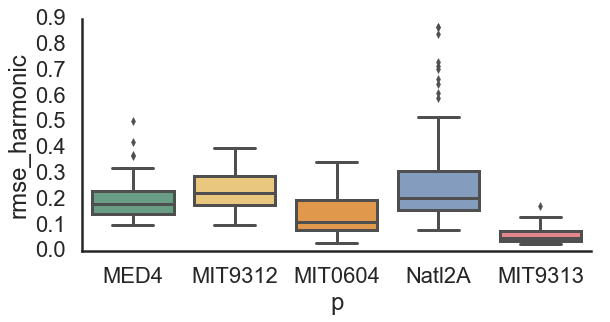

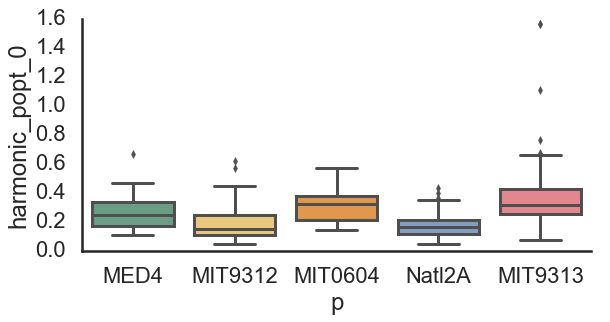

In [38]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture=='Axenic','p'] = dfscore.loc[dfscore.culture=='Axenic','p'] + '_Axenic'

for i in ['rmse_harmonic', 'harmonic_popt_0',  ]:
    sns.catplot(data=dfscore.loc[#(dfscore.culture =='Co_Culture') &
                                dfscore.experiment_sample.isin(
                                    best_model_df.loc[best_model_df.model == 'harmonic', 'experiment_sample'])
                                ], 
                x='p', y=i, kind='box',
           order=porder, palette=ppallete,
           aspect=1.8)
    



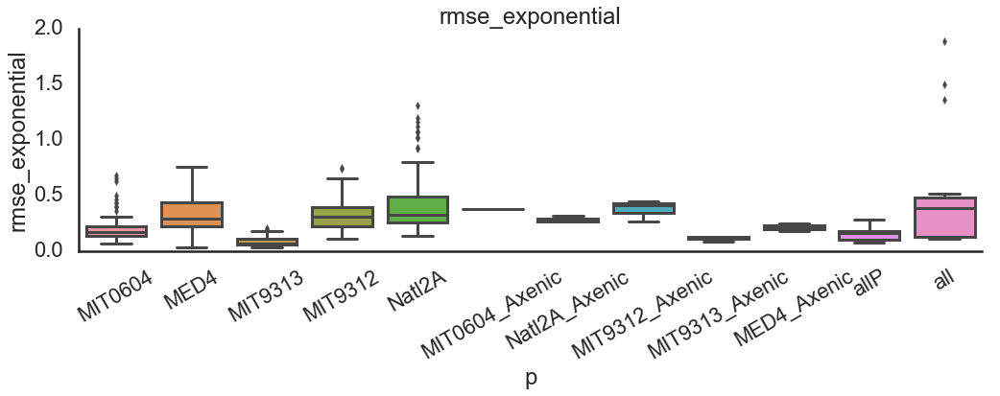

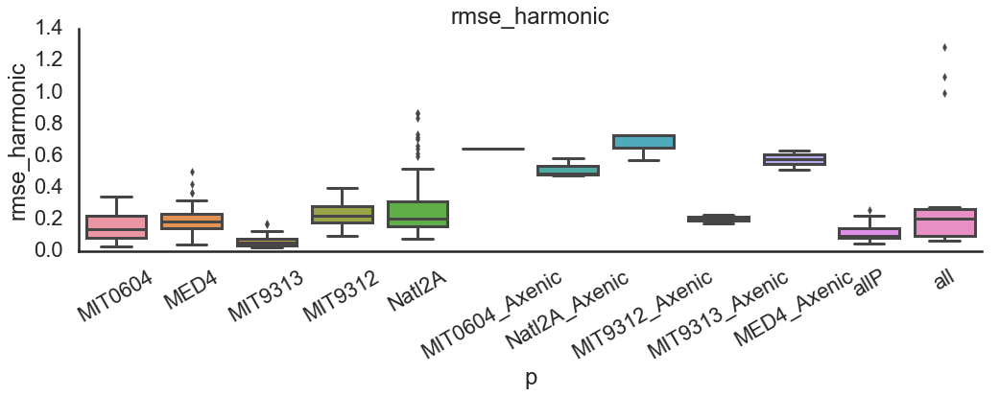

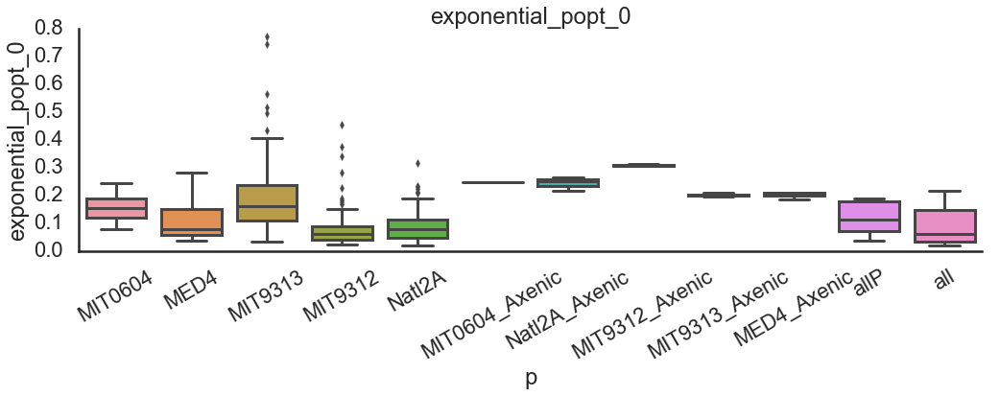

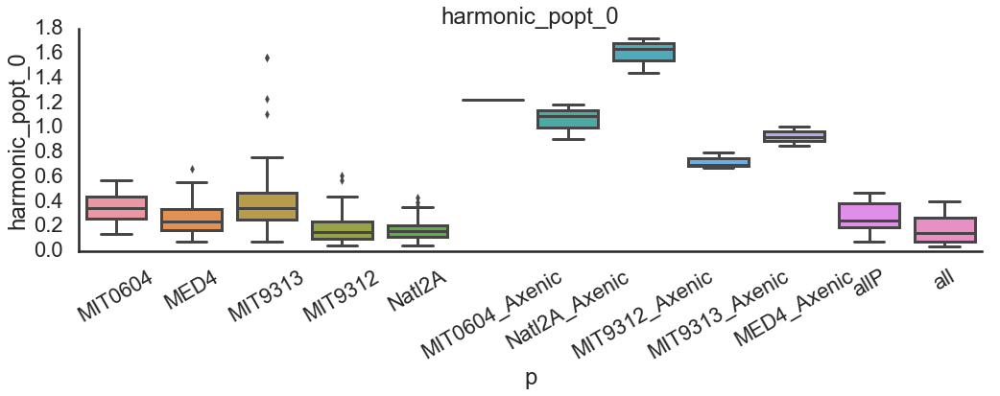

In [39]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['rmse_exponential','rmse_harmonic', 'exponential_popt_0',  'harmonic_popt_0']:
    sns.catplot(data=dfscore, 
                x='p', y=i, kind='box',
           #order=porder, palette=ppallete,
           aspect=3)
    #plt.yscale('log')
    plt.xticks(rotation=30)
    plt.title(i)


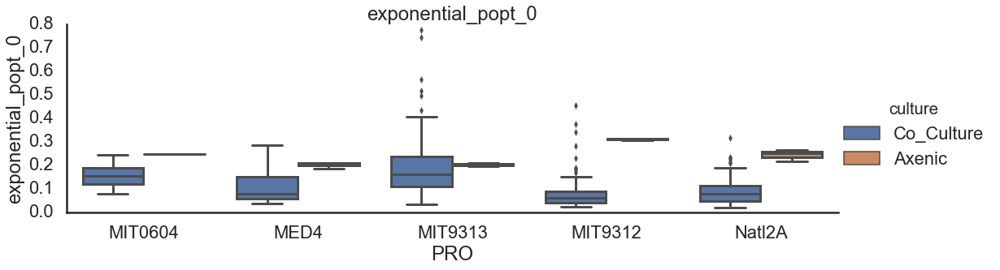

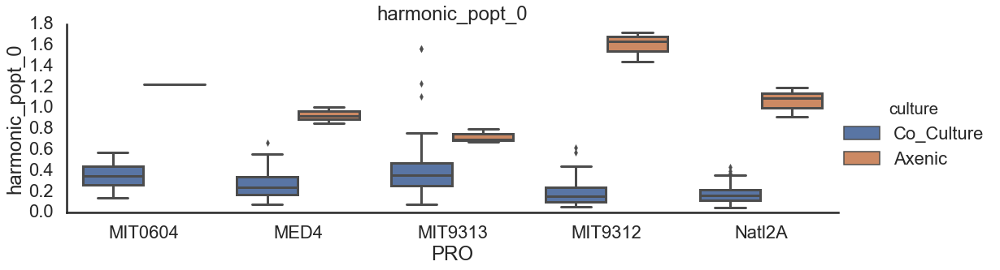

In [40]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0',  'harmonic_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic'])], 
                x='PRO', y=i, kind='box',
                hue='culture',
           #order=porder, palette=ppallete,
           aspect=3)
    #plt.yscale('log')
    #plt.xticks(rotation=30)
    plt.title(i)


(0, 1.4)

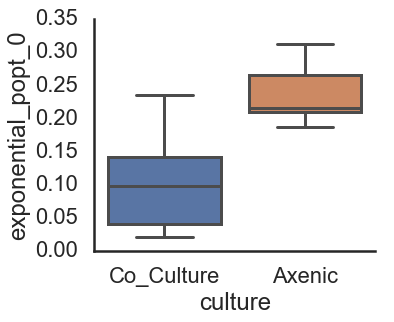

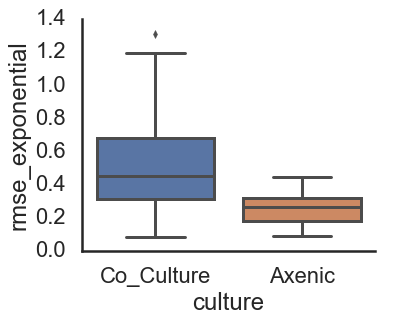

In [41]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                             dfscore.experiment.isin(['e1'])], 
            #x='PRO', 
            y='exponential_popt_0', kind='box',
            x='culture',
       aspect=1.2
            
           )
plt.ylim(0,0.35)

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                             dfscore.experiment.isin(['e1'])], 
            #x='PRO', 
            y='rmse_exponential', kind='box',
            x='culture',
       aspect=1.2
            
           )
plt.ylim(0,1.4)



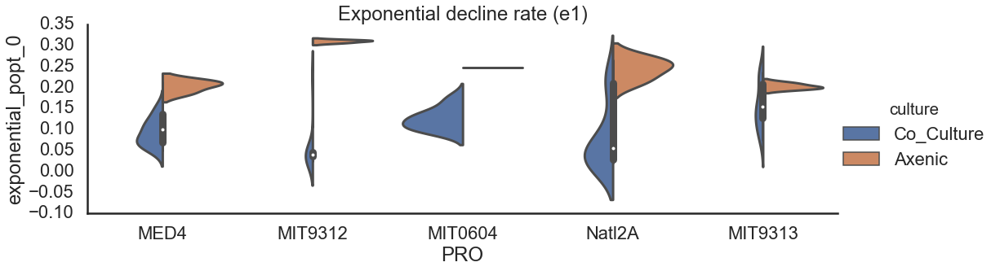

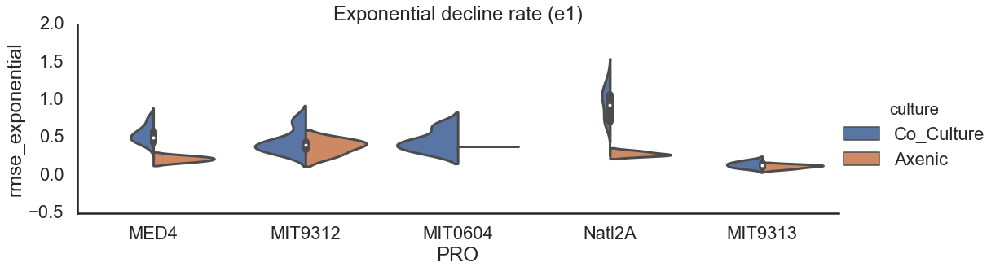

In [42]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                                 dfscore.experiment.isin(['e1'])], 
                x='PRO', 
                y=i, kind='violin',
                hue='culture',
                split=True,
           order=porder, #palette=ppallete,
           aspect=3
               )
    #plt.yscale('log')
    #plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('Exponential decline rate (e1)')


(0, 1.4)

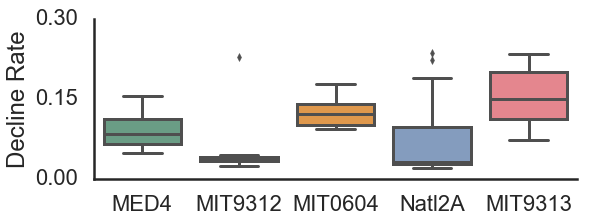

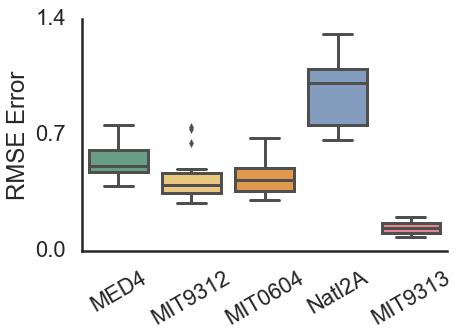

In [148]:
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='exponential_popt_0', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=2.2, height=4,
           ).set(yticks=[0,0.15,0.3]).set_axis_labels('','Decline Rate')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='rmse_exponential', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=1.4, height=5
           ).set(yticks=[0,0.7,1.4]).set_axis_labels('','RMSE Error')
#plt.yscale('log')
plt.xticks(rotation=30)
plt.ylim(0,1.4)


(0, 1.4)

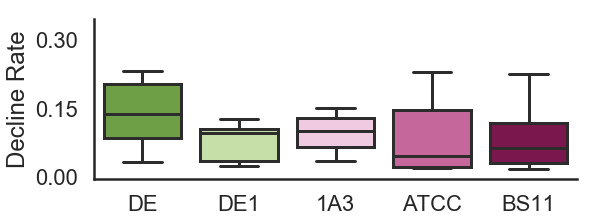

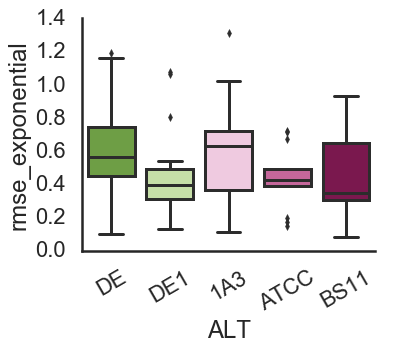

In [149]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='exponential_popt_0', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=2.2, height=4,
           ).set(yticks=[0,0.15,0.3]).set_axis_labels('','Decline Rate')
#plt.yscale('log')
#plt.xticks(rotation=30)
plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='rmse_exponential', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=1.2
           )
#plt.yscale('log')
plt.xticks(rotation=30)
plt.ylim(0,1.4)


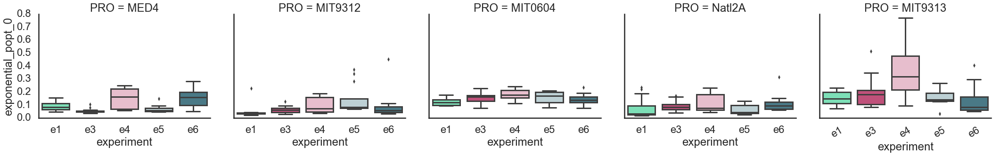

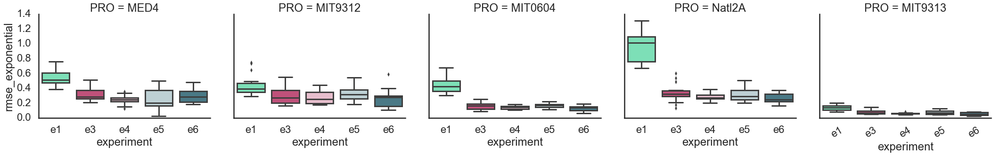

In [45]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='PRO', 
                x='experiment',
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
                col_order=porder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


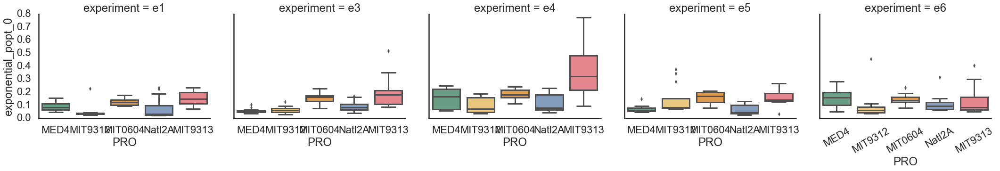

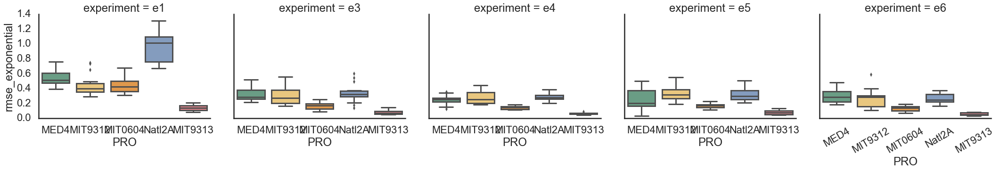

In [46]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='experiment', 
                x='PRO',
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
                col_order=eorder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


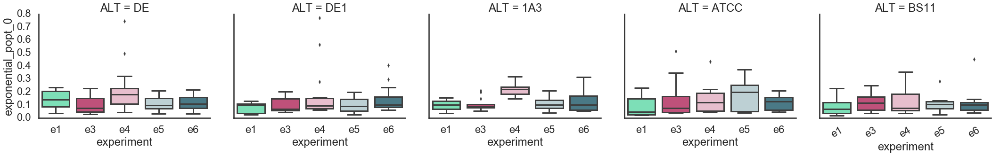

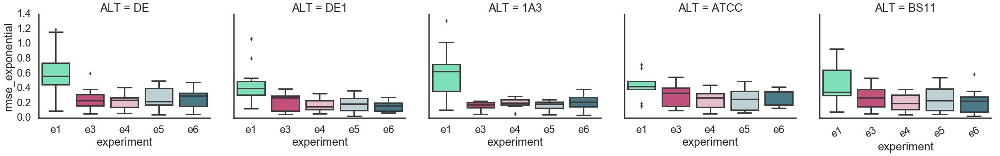

In [47]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='ALT', 
                x='experiment',
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
                col_order=aorder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


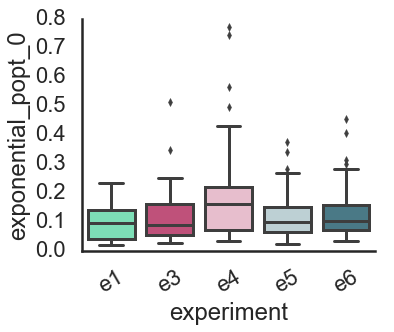

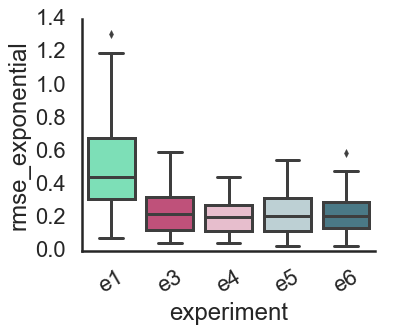

In [48]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='experiment', 
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


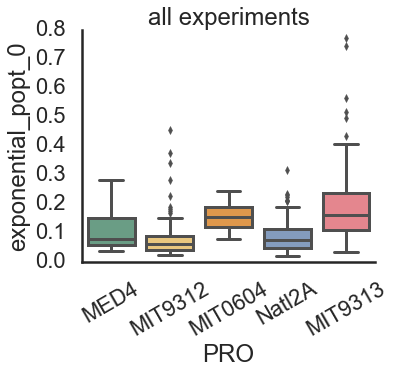

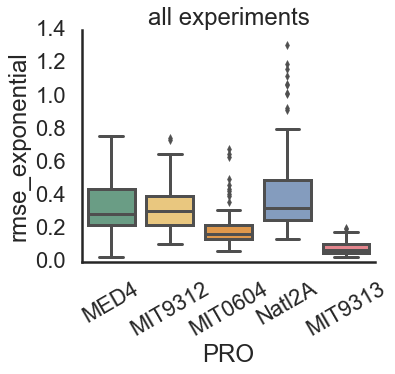

In [49]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='PRO', 
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    plt.title('all experiments')


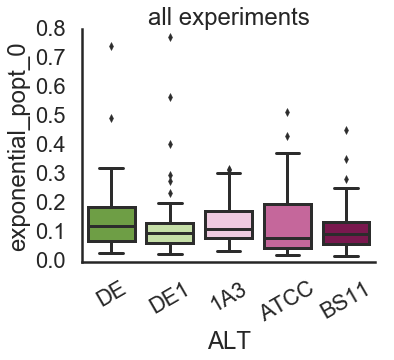

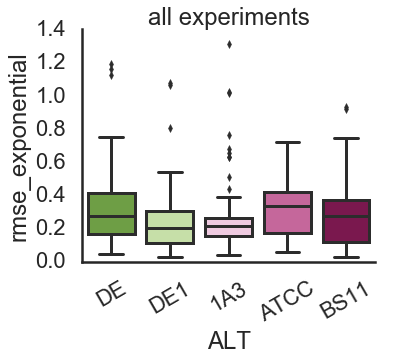

In [50]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='ALT', 
                y=i, kind='box',
                #col='culture',
           order=aorder, palette=apallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('all experiments')


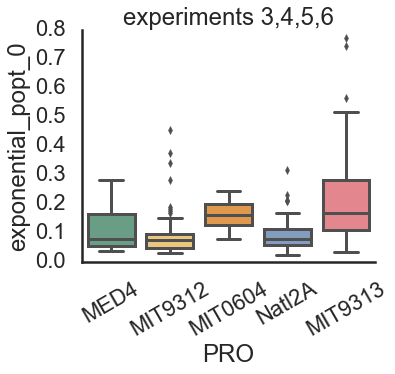

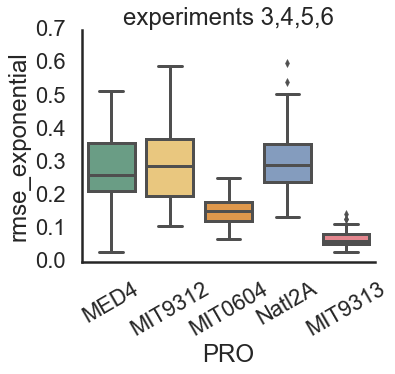

In [51]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & (~dfscore.experiment.isin(['e1'])) ], 
                x='PRO', 
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    plt.title('experiments 3,4,5,6')


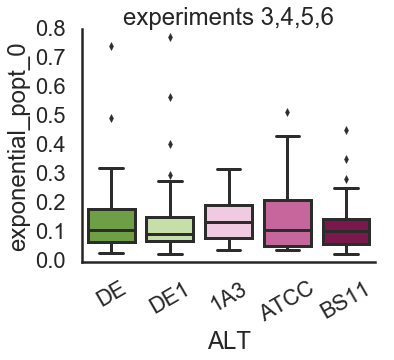

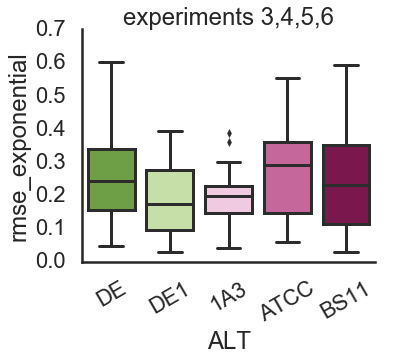

In [52]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & (~dfscore.experiment.isin(['e1'])) ], 
                x='ALT', 
                y=i, kind='box',
                #col='culture',
           order=aorder, palette=apallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('experiments 3,4,5,6')


In [53]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('exponential_popt_0 ~ C(PRO)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of PRO strain')
pair_t = mod.t_test_pairwise("C(PRO)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of PRO strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:     exponential_popt_0   R-squared:                       0.358
Model:                            OLS   Adj. R-squared:                  0.321
Method:                 Least Squares   F-statistic:                     9.492
Date:                Tue, 05 May 2020   Prob (F-statistic):           3.71e-06
Time:                        18:45:28   Log-Likelihood:                 115.65
No. Observations:                  73   AIC:                            -221.3
Df Residuals:                      68   BIC:                            -209.8
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept             0.0920      0.01

In [54]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('exponential_popt_0 ~ C(ALT)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of ALT strain')
pair_t = mod.t_test_pairwise("C(ALT)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of ALT strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:     exponential_popt_0   R-squared:                       0.125
Model:                            OLS   Adj. R-squared:                  0.074
Method:                 Least Squares   F-statistic:                     2.431
Date:                Tue, 05 May 2020   Prob (F-statistic):             0.0558
Time:                        18:45:28   Log-Likelihood:                 104.33
No. Observations:                  73   AIC:                            -198.7
Df Residuals:                      68   BIC:                            -187.2
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.0998      0.016      6.

In [55]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('rmse_exponential ~ C(PRO)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of PRO strain')
pair_t = mod.t_test_pairwise("C(PRO)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of PRO strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:       rmse_exponential   R-squared:                       0.806
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     70.70
Date:                Tue, 05 May 2020   Prob (F-statistic):           1.69e-23
Time:                        18:45:28   Log-Likelihood:                 44.745
No. Observations:                  73   AIC:                            -79.49
Df Residuals:                      68   BIC:                            -68.04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept             0.5465      0.03

In [56]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('rmse_exponential ~ C(ALT)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of ALT strain')
pair_t = mod.t_test_pairwise("C(ALT)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of ALT strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:       rmse_exponential   R-squared:                       0.061
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     1.096
Date:                Tue, 05 May 2020   Prob (F-statistic):              0.366
Time:                        18:45:29   Log-Likelihood:                -12.859
No. Observations:                  73   AIC:                             35.72
Df Residuals:                      68   BIC:                             47.17
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.5887      0.077      7.

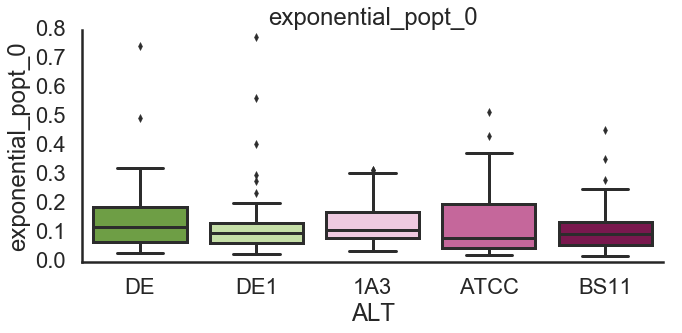

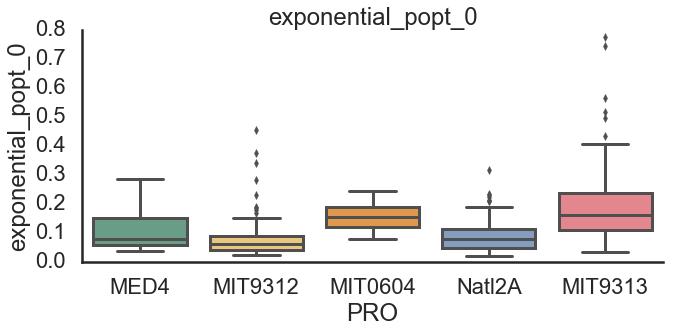

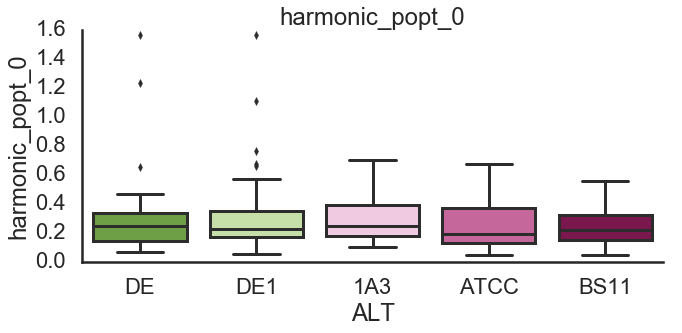

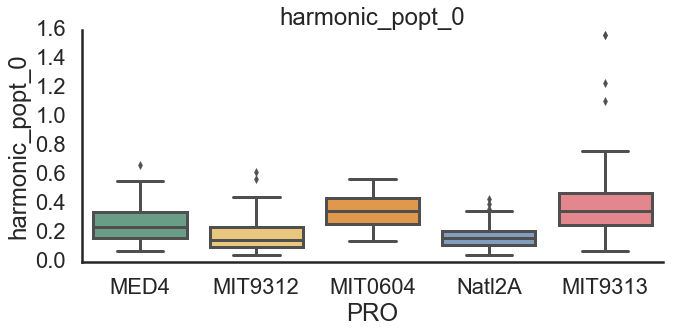

In [57]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0',  'harmonic_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='ALT', y=i, kind='box',
                #hue='culture',
           order=aorder, palette=apallete,
                aspect=2,
           )
    plt.title(i)

    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='PRO', y=i, kind='box',
                #hue='culture',
           order=porder, palette=ppallete,
                aspect=2,
           )
    plt.title(i)
    

(0, 0.6)

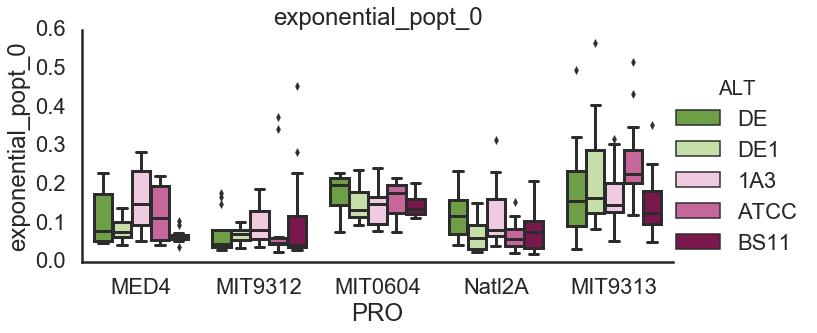

In [58]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='PRO', y=i, kind='box', hue='ALT',
                #hue='culture',
           hue_order=aorder, palette=apallete,
                order=porder,
                aspect=2,
           )
    plt.title(i)
plt.ylim(0,0.6)

In [59]:
best_model_df.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'model', 'RMSE', 's', 'e', 'p'],
      dtype='object')

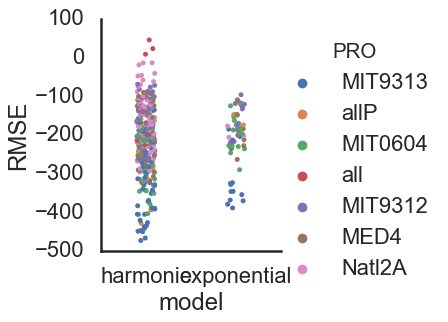

In [60]:
sns.catplot(data=best_model_df, x='model', y='RMSE', hue='PRO')

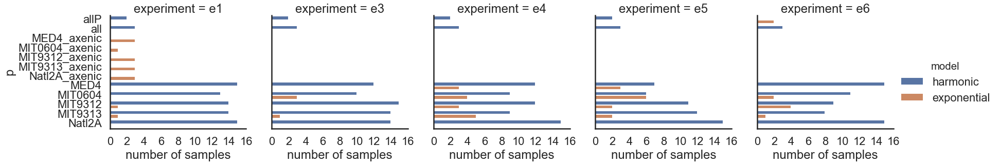

In [61]:
df_best_count = best_model_df.groupby(['culture','p', 'experiment',  'model'])['sample'].count().reset_index()
#df_best_count.model =df_best_count.model.map({'bic_exponential': 'exponential', 'bic_harmonic': 'harmonic'})
df_best_count.rename(columns={'sample': 'number of samples'}, inplace=True)

sns.catplot(data=df_best_count,y='p', hue='model', x='number of samples', #row='culture',
            col='experiment', kind='bar')

In [62]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture,exponential,exponential_popt_0,exponential_popt_1,exponential_popt_2,harmonic,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture,5.621000,0.141021,1.0,1.0,5.621000,0.296513,0.5,0.5
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture,4.955857,0.141021,1.0,1.0,4.444171,0.296513,0.5,0.5
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture,4.244581,0.141021,1.0,1.0,3.533985,0.296513,0.5,0.5
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture,2.898240,0.141021,1.0,1.0,2.349141,0.296513,0.5,0.5
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture,2.516052,0.141021,1.0,1.0,2.089493,0.296513,0.5,0.5


In [63]:
dfdecline['exponential_error'] = dfdecline['FL'] - dfdecline['exponential']
dfdecline['harmonic_error'] = dfdecline['FL'] - dfdecline['harmonic']


In [64]:
value_vars = [ 'FL', 'exponential', #'hyperbolic',
              'harmonic', 'exponential_error','harmonic_error',
             ]
id_vars = ['experiment_sample', 'day',  'experiment', 'sample', 'PRO', 'ALT',
       'culture', ]      
dfresm = dfdecline.melt(value_vars=value_vars, id_vars=id_vars )

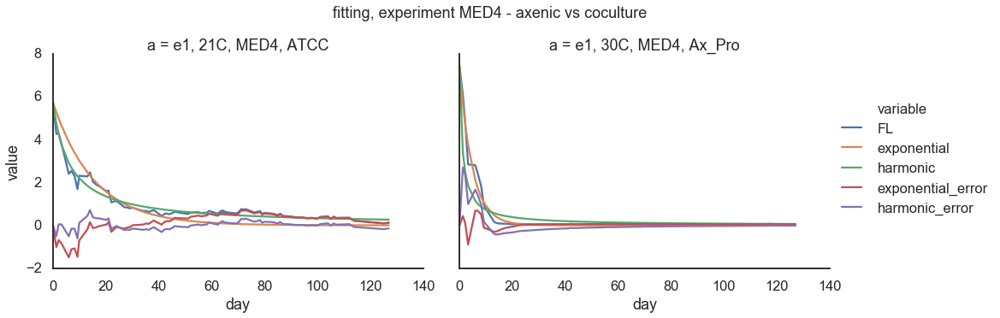

In [65]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

for p in ['Natl2A']:
    for e in ['e1']:
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & #(dfresm.PRO == p) &
                                   (dfresm['sample'].isin(['21C', '30C']))], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                #col_wrap=6,
                kind='line',
                    aspect=1.4
               )
        plt.suptitle(f'fitting, experiment MED4 - axenic vs coculture', y=1.05)
        plt.show()

In [66]:
dfresm.ALT.unique()

array(['DE', 'DE1', 'BS11', '1A3', 'ATCC', 'Ax_Pro', 'all_Pro', 'all'],
      dtype=object)

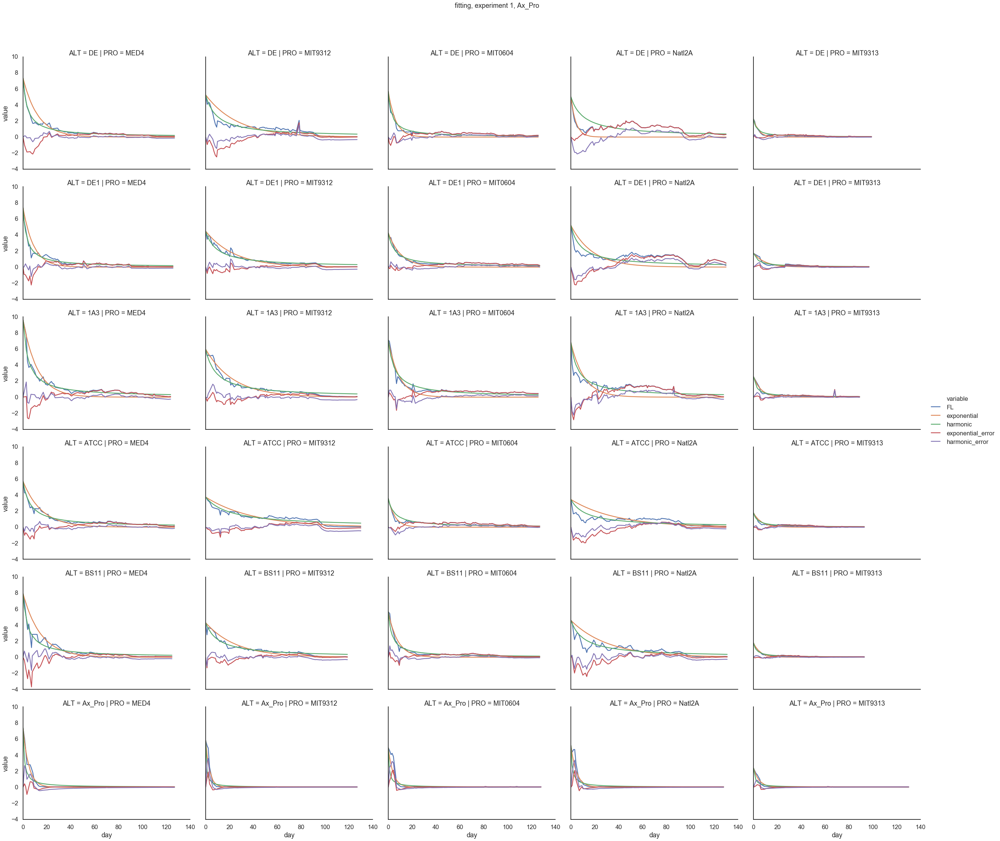

In [67]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

for a in ['Ax_Pro']:
    for e in ['e1']:
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & (dfresm.ALT.isin(aorder + ['Ax_Pro'])) &
                                    (dfresm['sample'].str.endswith('C'))
                                   #(dfresm['sample'].isin(['21C', '30C']))
                                   ], 
                x='day',
                y='value',
                hue='variable',
                col='PRO',
                    row='ALT',
                    row_order=aorder+ ['Ax_Pro'],
                    col_order=porder ,
                #col_wrap=5,
                kind='line',
                    aspect=1.4
               )
        plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
        plt.show()

In [68]:
porder

['MED4', 'MIT9312', 'MIT0604', 'Natl2A', 'MIT9313']

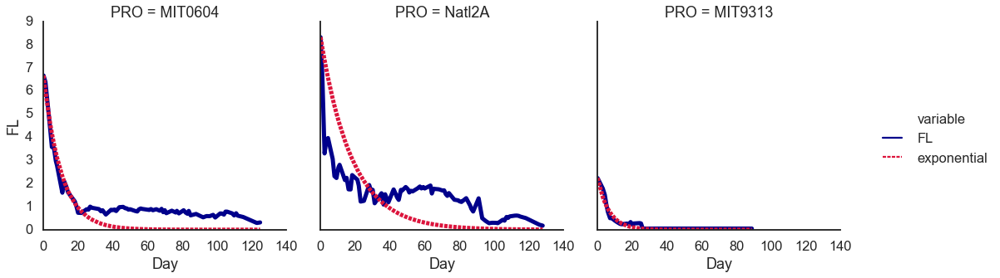

In [69]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['FL', 'exponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=['MIT0604', 'Natl2A', 'MIT9313'],
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=5,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

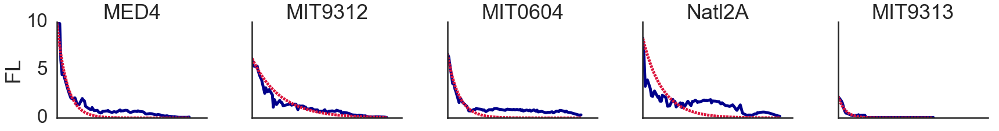

In [120]:
sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['FL', 'exponential'])) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=5,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            palette=['DarkBlue','Crimson'],
            #col_wrap=3,
            legend=False
       ).set_axis_labels('','FL').set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

KeyboardInterrupt: 

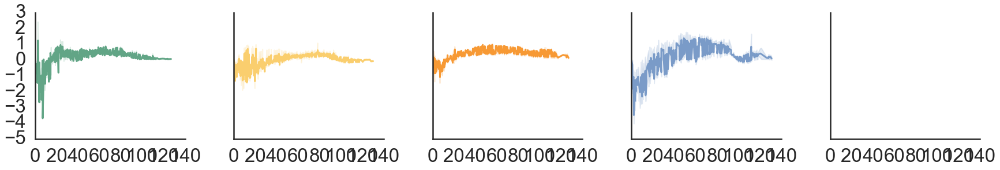

In [121]:
sns.set_context('poster')
sns.set(font_scale=1.5, style='white', context='poster')

g = sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

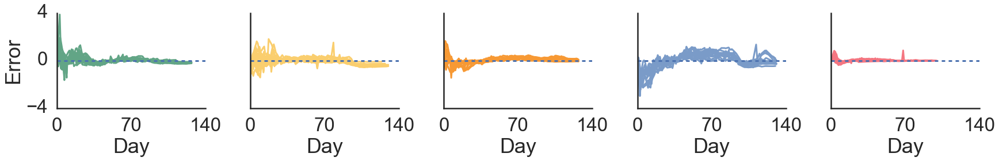

In [122]:
sns.set(font_scale=1.5, style='white', context='poster')

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['harmonic_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
        #col_wrap=5,
        kind='line',
                estimator=None, units='experiment_sample',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
                legend=False
       ).set_axis_labels('Day','Error').set(xticks=[0,70,140], yticks=[-4,0, 4]).set_titles('')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
#plt.title('harmonic error - e1')
plt.show()

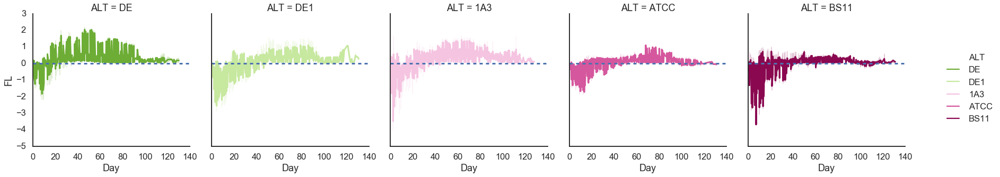

In [73]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='ALT',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=aorder,
            #col_wrap=2,
            hue='ALT', hue_order=aorder, palette=apallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

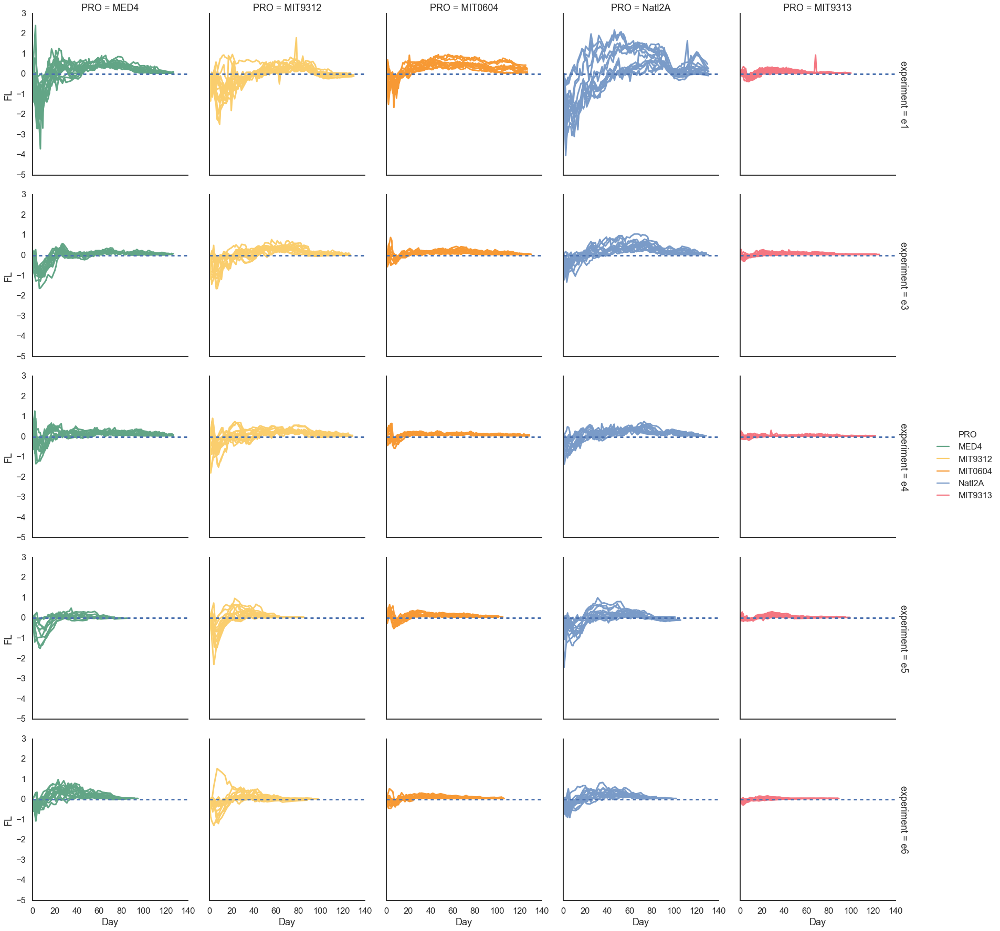

In [74]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[#(dfresm.experiment == 'e1') & 
                                (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
                row='experiment',
                units='sample', estimator=None,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

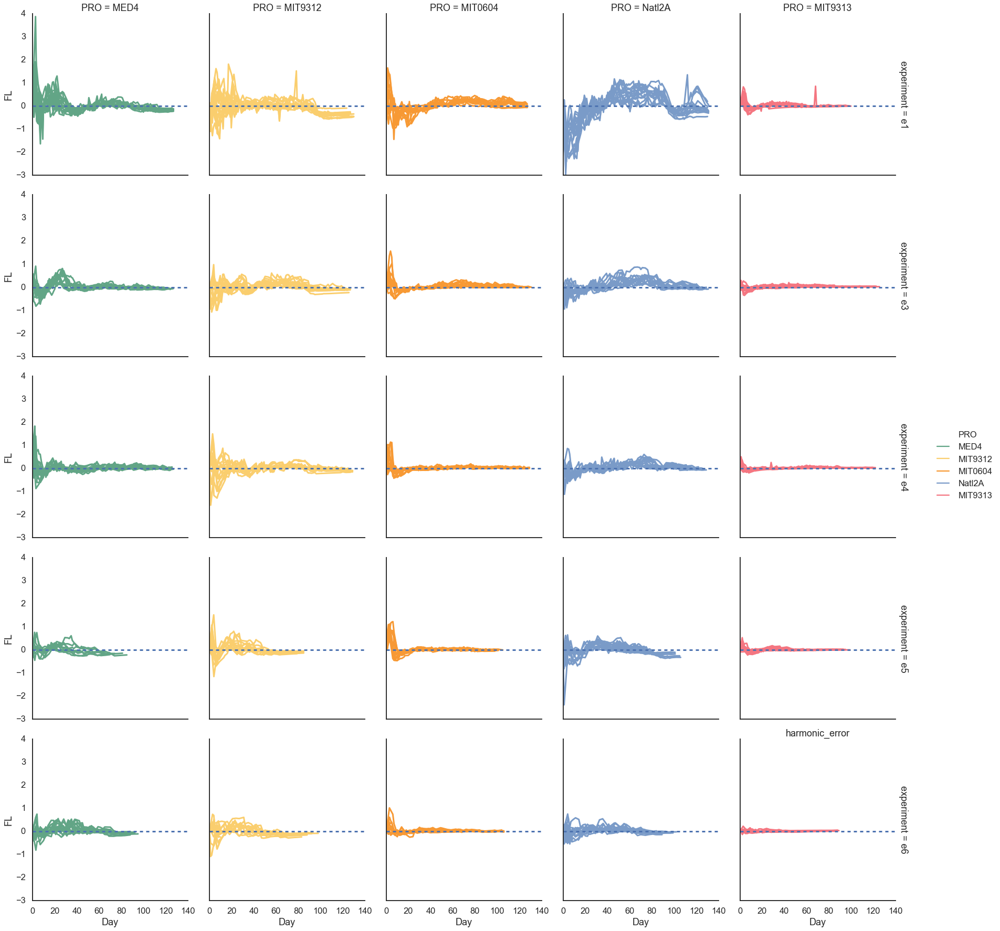

In [75]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[#(dfresm.experiment == 'e1') & 
                                (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['harmonic_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
                row='experiment',
                units='sample', estimator=None,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
plt.title('harmonic_error')
plt.show()

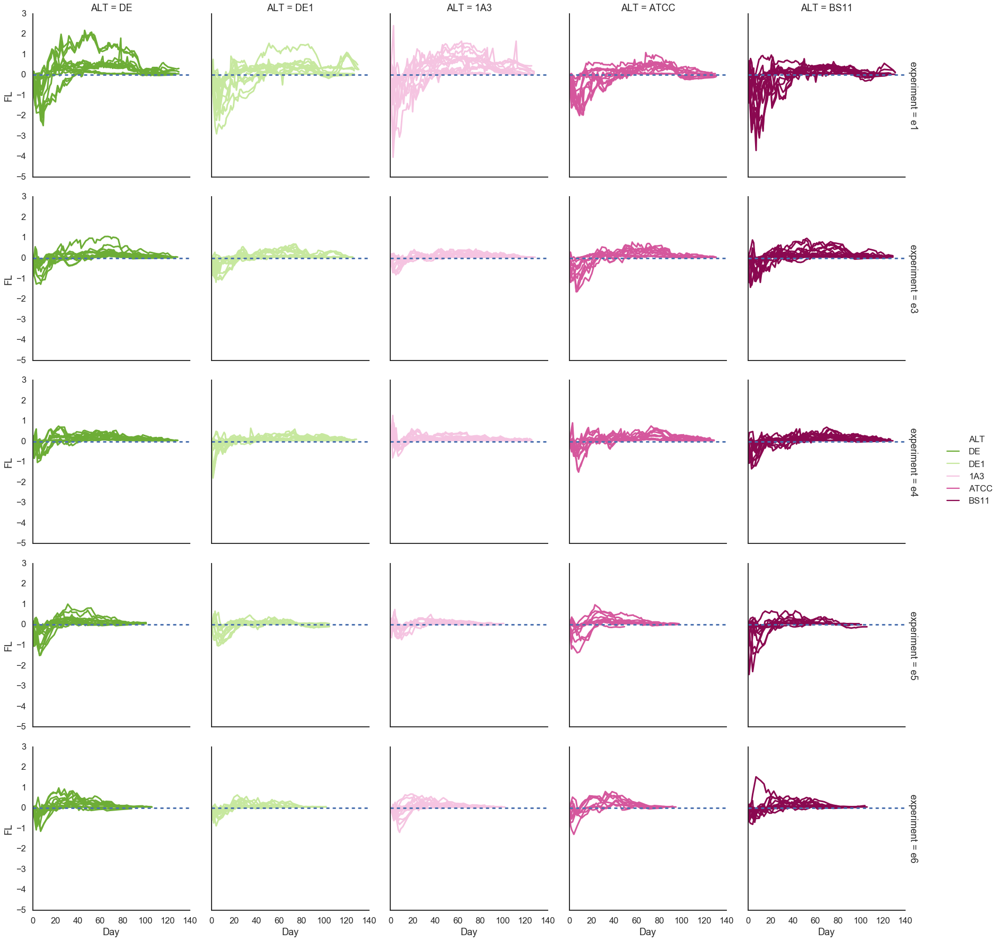

In [76]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
g = sns.relplot(data=dfresm.loc[#(dfresm.experiment == 'e1') & 
                                (~dfresm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='ALT',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=aorder,
            #col_wrap=2,
            hue='ALT', hue_order=aorder, palette=apallete,
                row='experiment',
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
                units='sample', estimator=None,
                
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
       ).set_axis_labels('Day','FL')
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

In [77]:
df1 = dfresm.loc[(dfresm.experiment == 'e1') & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dfresm.culture.isin(['Co_Culture', 'Axenic'])) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)

Variance percent explained
 [0.80500041 0.16879936]


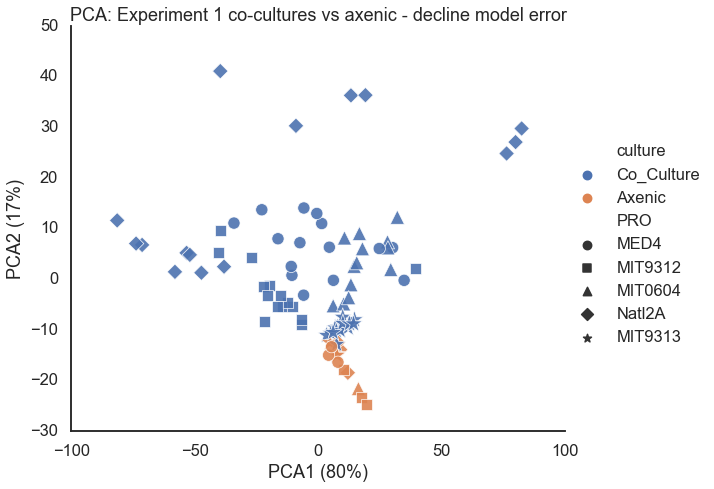

In [78]:
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', #hue='PRO', 
        hue='culture', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            size='PRO', size_order=porder,
                 sizes=psizes, 
            #     s=150,
                 alpha=0.9, height=7, aspect=1.2,
            #palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (17%)')
plt.title('PCA: Experiment 1 co-cultures vs axenic - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

Variance percent explained
 [0.8038343  0.15913819]


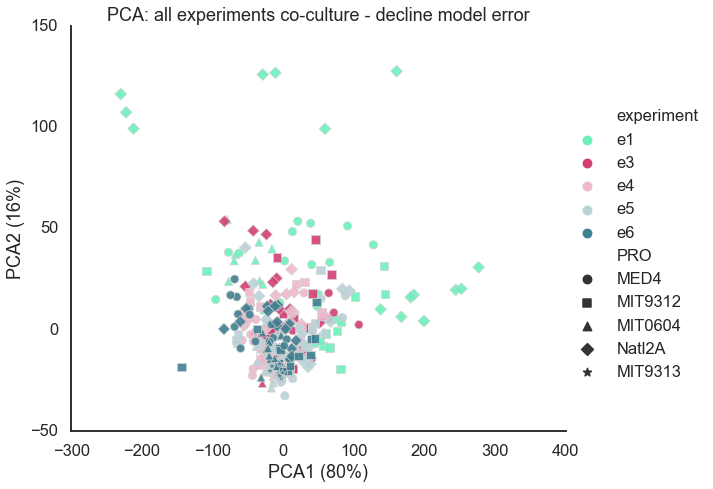

In [79]:
df1 = dfresm.loc[#(dfresm.experiment == 'e1') & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dfresm.culture.isin(['Co_Culture',])) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='experiment', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=70,
                 alpha=0.9, height=7, aspect=1.2,
            palette=epallete, hue_order=eorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (16%)')
plt.title('PCA: all experiments co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

Variance percent explained
 [0.80452333 0.14319194]


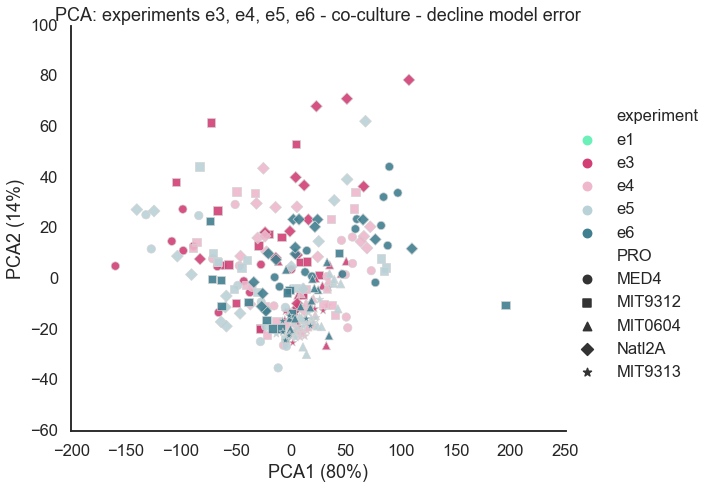

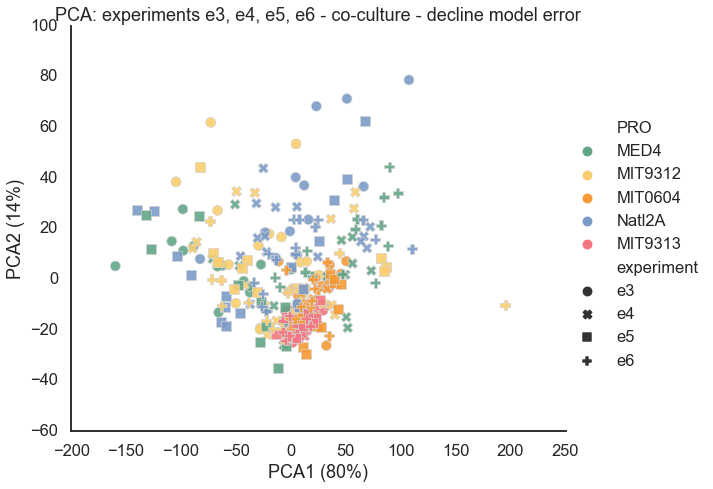

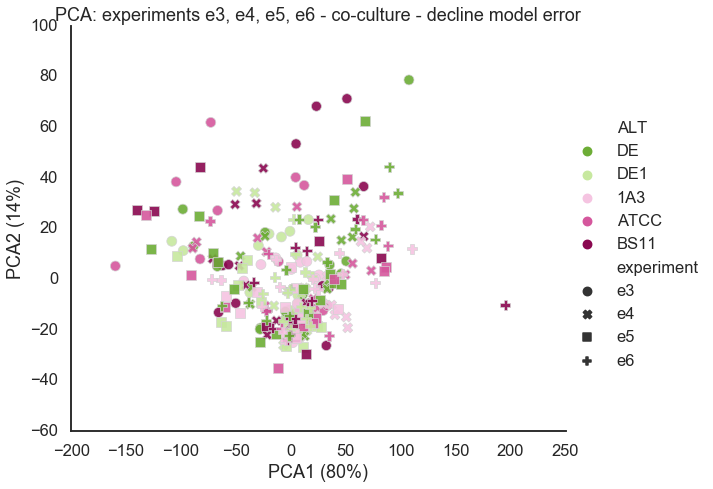

In [80]:
df1 = dfresm.loc[(~dfresm.experiment.isin(['e1'])) & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dfresm.culture.isin(['Co_Culture',])) &
                            (dfresm['variable'].isin(['exponential_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='experiment', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=70,
                 alpha=0.9, height=7, aspect=1.2,
            palette=epallete, hue_order=eorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e3, e4, e5, e6 - co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])
plt.show()
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='PRO', 
            style='experiment',
            #style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=100,
                 alpha=0.9, height=7, aspect=1.2,
            palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e3, e4, e5, e6 - co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])
plt.show()
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='ALT', 
            style='experiment',
            #style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=100,
                 alpha=0.9, height=7, aspect=1.2,
            palette=apallete, hue_order=aorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e3, e4, e5, e6 - co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

Variance percent explained
 [0.8280688 0.1431597]


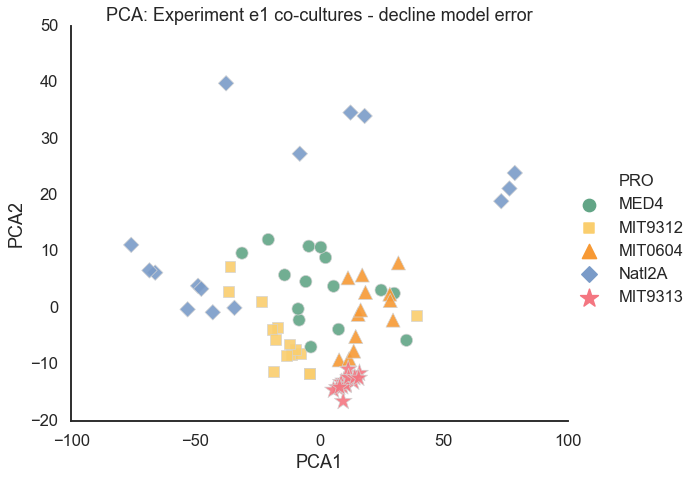

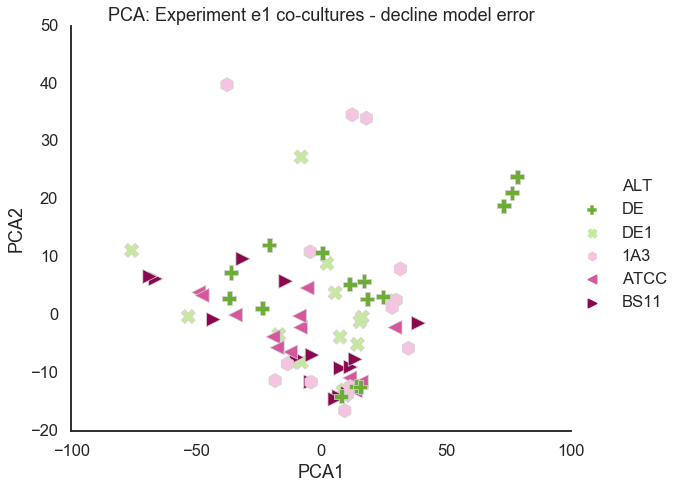

Variance percent explained
 [0.76290549 0.19810636]


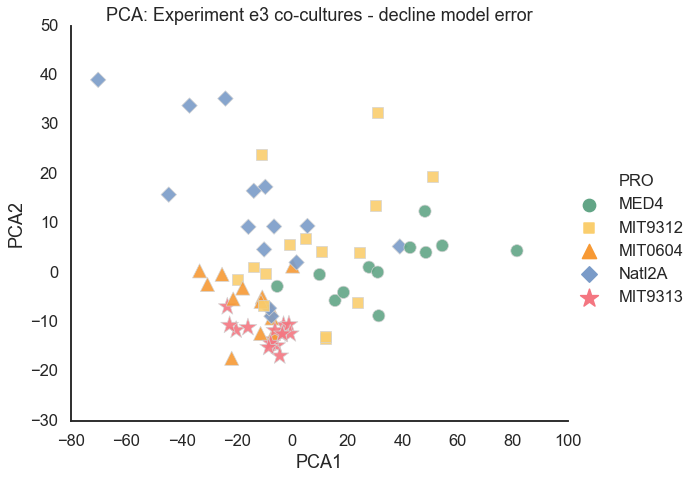

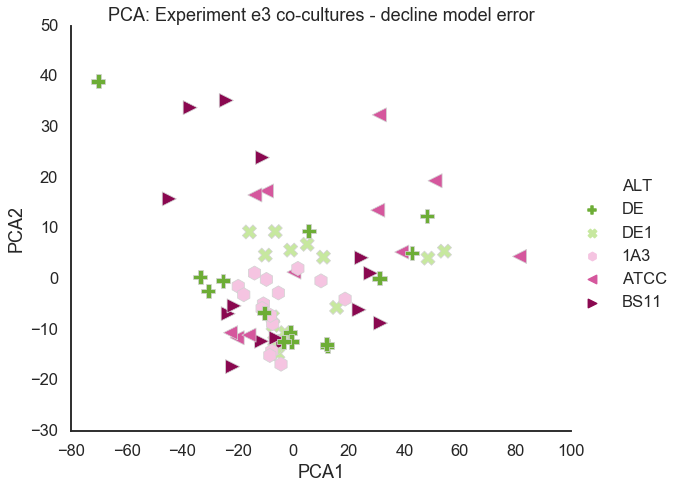

Variance percent explained
 [0.75694378 0.19589784]


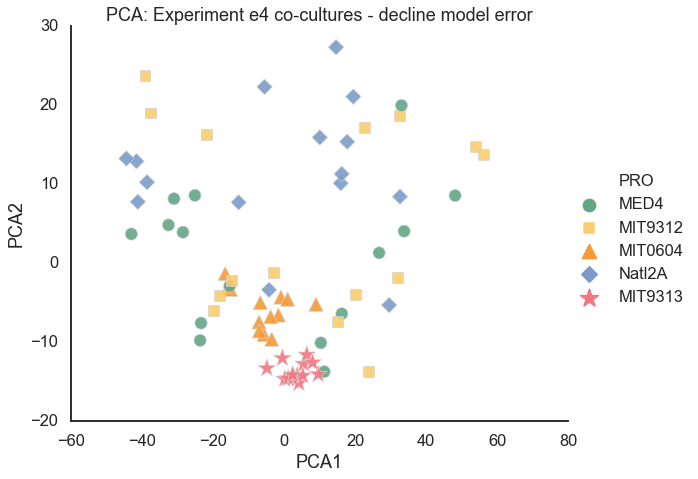

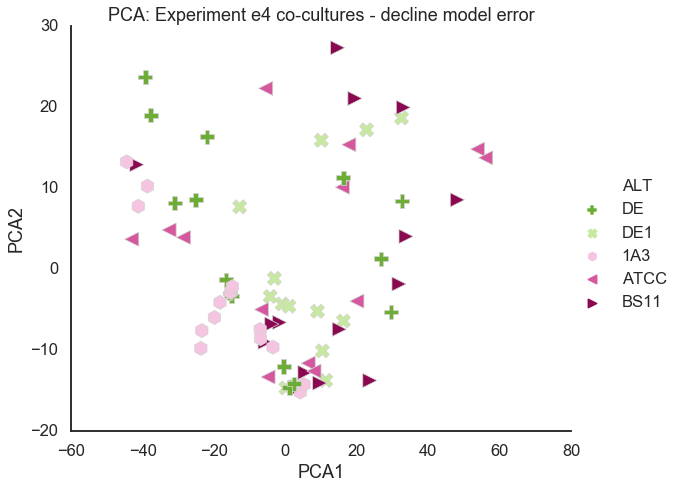

Variance percent explained
 [0.85341773 0.10997269]


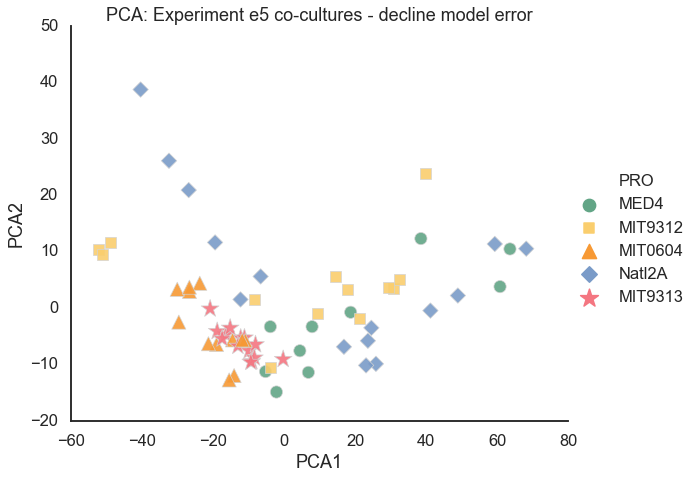

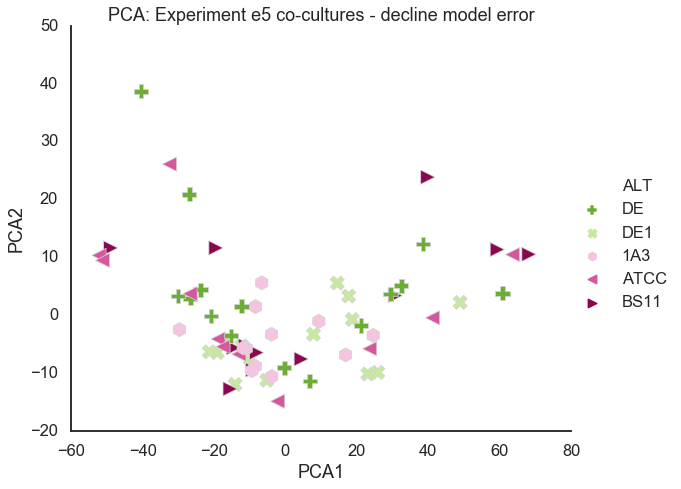

Variance percent explained
 [0.80274295 0.14671531]


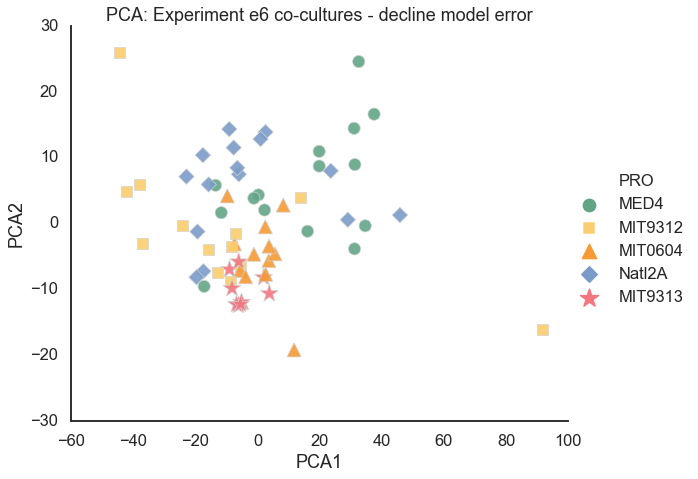

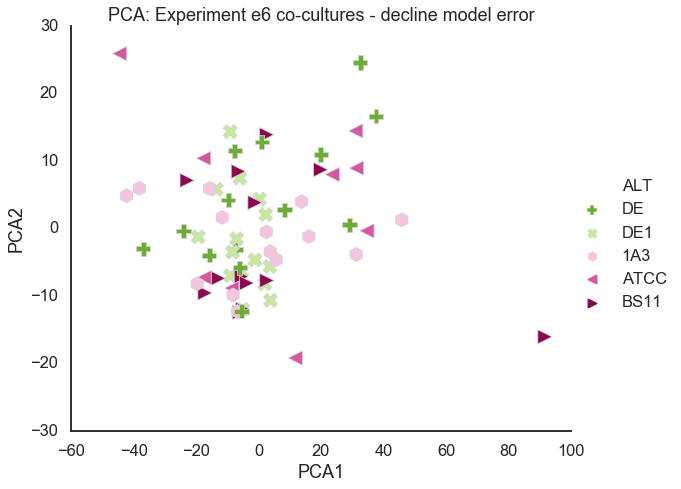

In [81]:
for e in eorder:
    df1 = dfresm.loc[(dfresm.experiment == e) & 
                                    #(~dfresm.ALT.isin(['Ax_Pro'])) &
                     (dfresm.culture.isin(['Co_Culture'])) &
                                (dfresm['variable'].isin(['exponential_error'])) 
                               ]
    sample_col = 'experiment_sample'
    #dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
    X = cp.experiments2X(df1, value_col='value', cumsummode=True)
    metadf = cp.get_meta(df1, value_col='value')
    #metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
    dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
    sns.set_context('talk')
    ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='PRO', 
            #style='culture', 
                style='PRO',
                style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder,
                     sizes=psizes, 
                     alpha=0.9, height=7, aspect=1.2,
                palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
                     col='culture',
               )
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.title(f'PCA: Experiment {e} co-cultures - decline model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
        plt.show()
    
    ax = sns.relplot(data=dfpca.loc[dfpca.culture.isin(['Co_Culture'])], x='PCA1', y='PCA2', hue='ALT', 
                #style='culture', 
                style='ALT',
                style_order=aorder, #markers=['p','h','<','v','>'],
                     markers=amarkers,
                s=200, #alpha=0.9, 
                     height=7, aspect=1.2,
                palette=apallete, 
                     hue_order=aorder ,edgecolor='lightgrey', 

                     #facet_kws=dict(subplot_kws=dict(fillstyle='none')) #fillstyle='none',
                     #facecolors= 'none'
               )
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.title(f'PCA: Experiment {e} co-cultures - decline model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
    plt.show()
    

Variance percent explained
 [0.74356247 0.20268803]


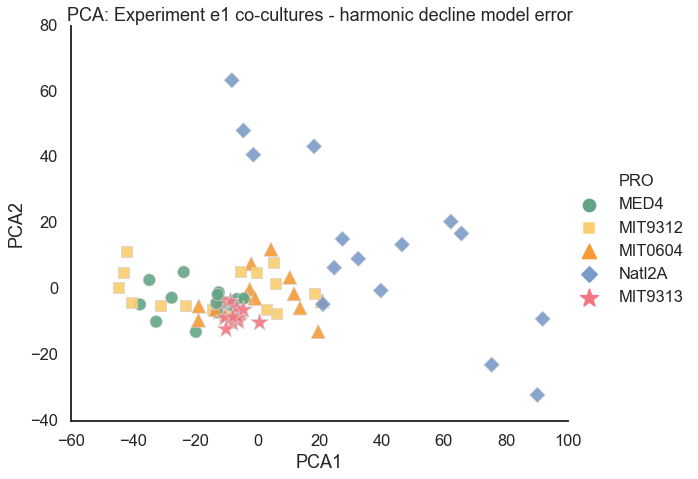

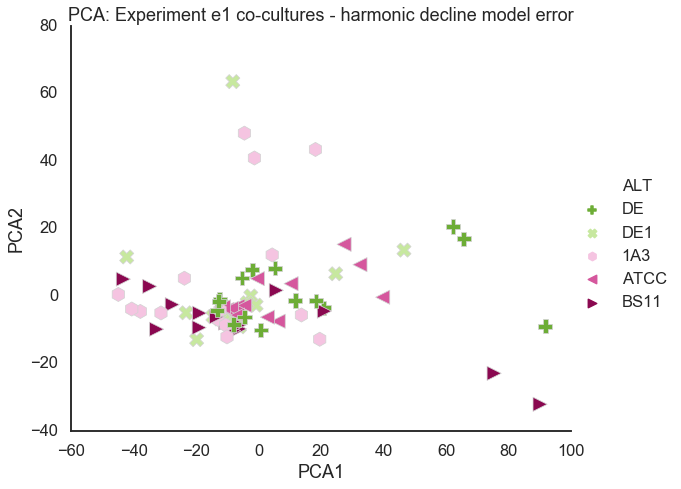

Variance percent explained
 [0.4914032  0.36478252]


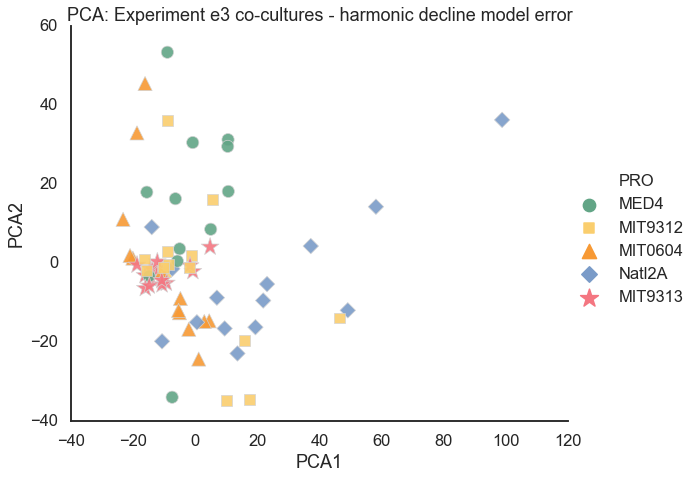

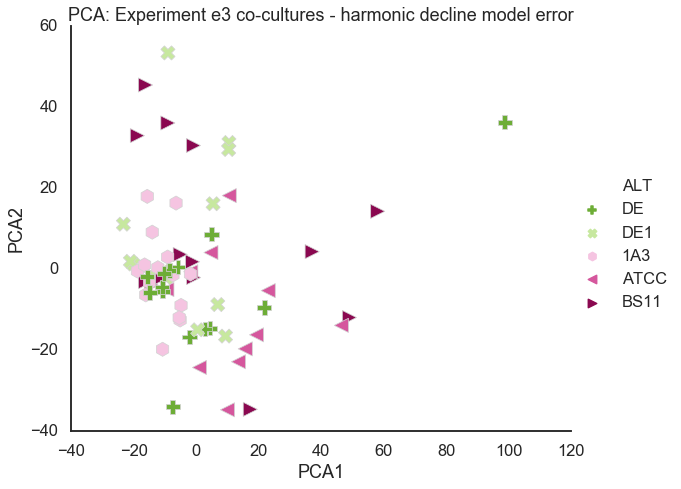

Variance percent explained
 [0.63886564 0.27004957]


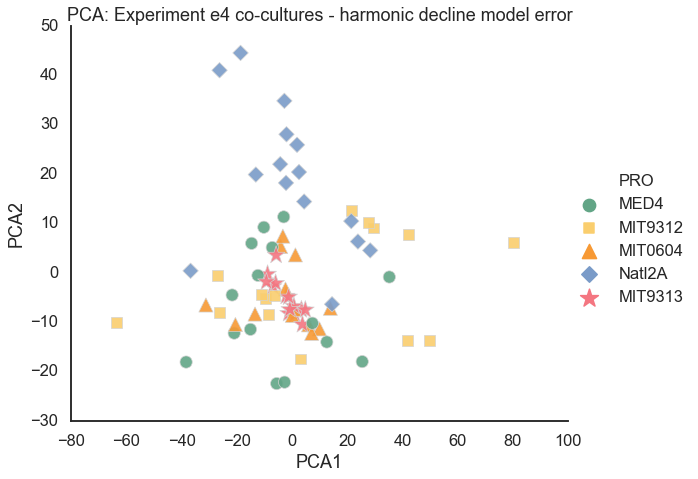

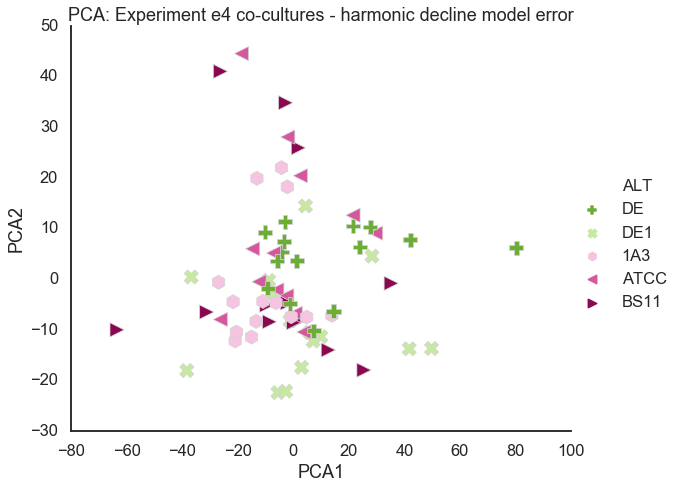

Variance percent explained
 [0.59265333 0.29525272]


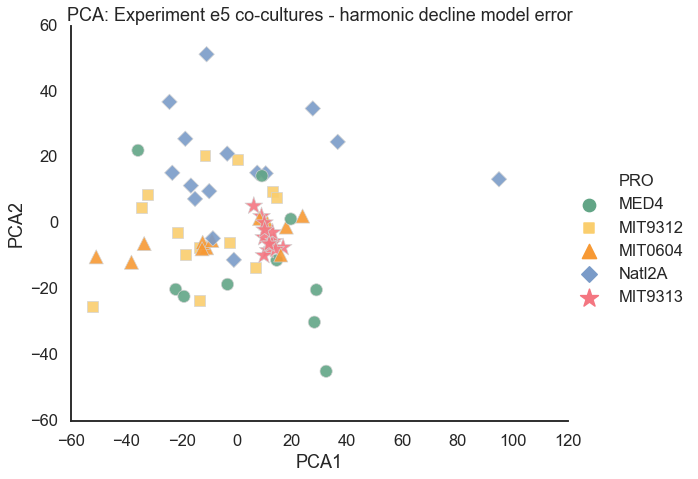

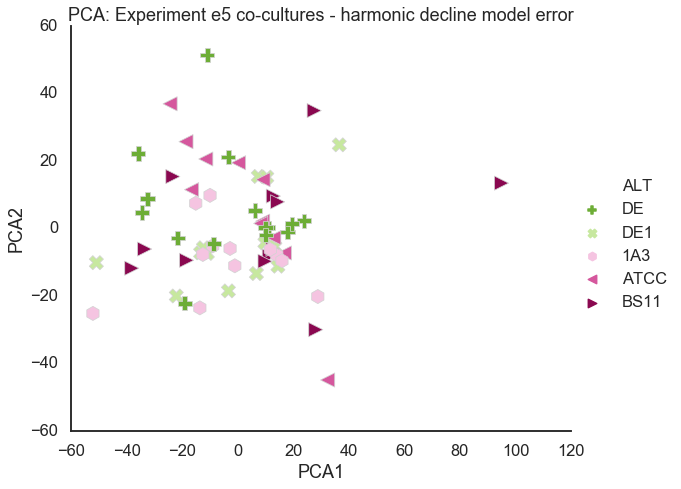

Variance percent explained
 [0.49719311 0.32726567]


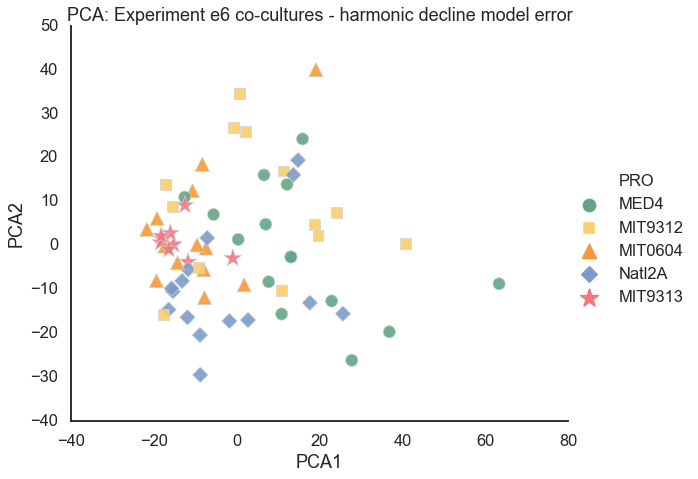

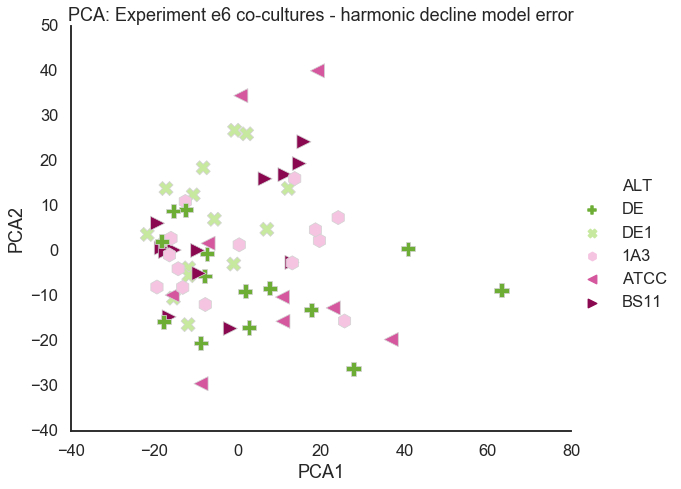

In [82]:
for e in eorder:
    df1 = dfresm.loc[(dfresm.experiment == e) & 
                                    #(~dfresm.ALT.isin(['Ax_Pro'])) &
                     (dfresm.culture.isin(['Co_Culture'])) &
                                (dfresm['variable'].isin(['harmonic_error'])) 
                               ]
    sample_col = 'experiment_sample'
    #dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
    X = cp.experiments2X(df1, value_col='value', cumsummode=True)
    metadf = cp.get_meta(df1, value_col='value')
    #metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
    dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
    sns.set_context('talk')
    ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='PRO', 
            #style='culture', 
                style='PRO',
                style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder,
                     sizes=psizes, 
                     alpha=0.9, height=7, aspect=1.2,
                palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
                     col='culture',
               )
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.title(f'PCA: Experiment {e} co-cultures - harmonic decline model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
        plt.show()
    
    ax = sns.relplot(data=dfpca.loc[dfpca.culture.isin(['Co_Culture'])], x='PCA1', y='PCA2', hue='ALT', 
                #style='culture', 
                style='ALT',
                style_order=aorder, #markers=['p','h','<','v','>'],
                     markers=amarkers,
                s=200, #alpha=0.9, 
                     height=7, aspect=1.2,
                palette=apallete, 
                     hue_order=aorder ,edgecolor='lightgrey', 

                     #facet_kws=dict(subplot_kws=dict(fillstyle='none')) #fillstyle='none',
                     #facecolors= 'none'
               )
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.title(f'PCA: Experiment {e} co-cultures - harmonic decline model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
    plt.show()
    

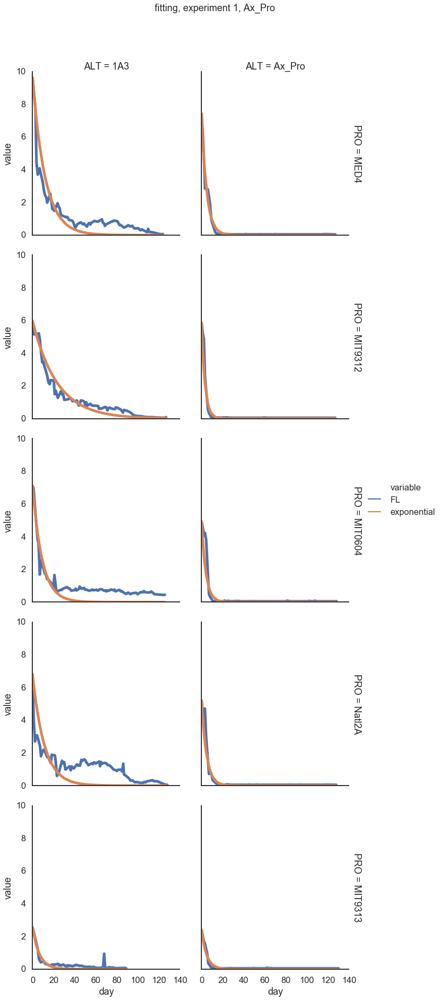

In [83]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3', 'Ax_Pro'])) &
                            (dfresm['sample'].str.endswith('C')) &
                            (dfresm['variable'].isin(['FL', 'exponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
        row='PRO',
            col='ALT',
            col_order=['1A3','Ax_Pro'],
            row_order=porder ,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=5,
       )
plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

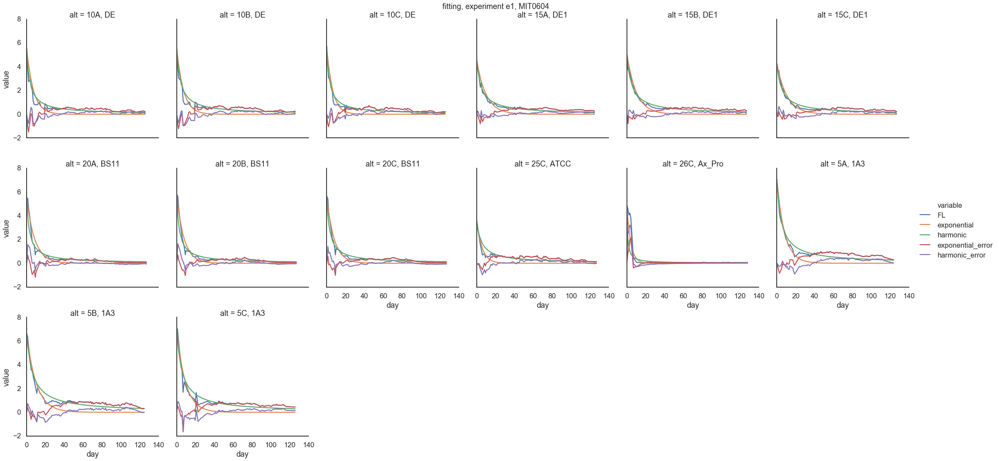

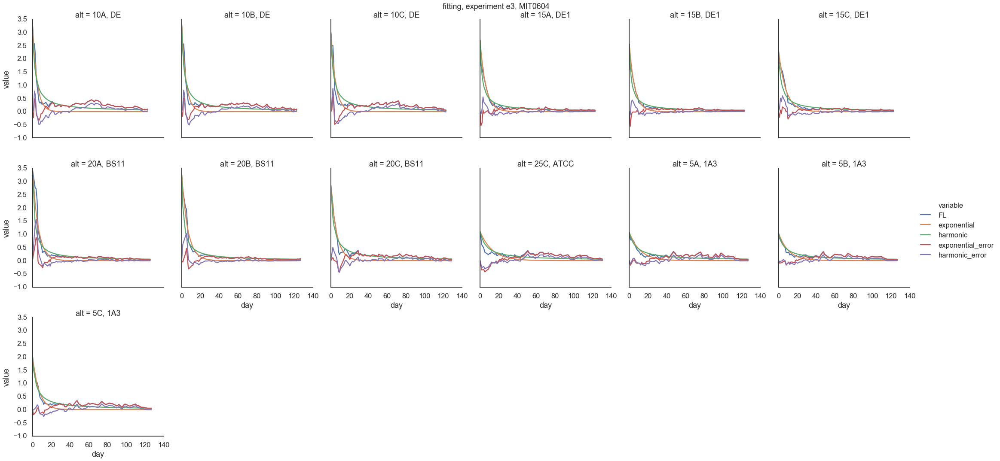

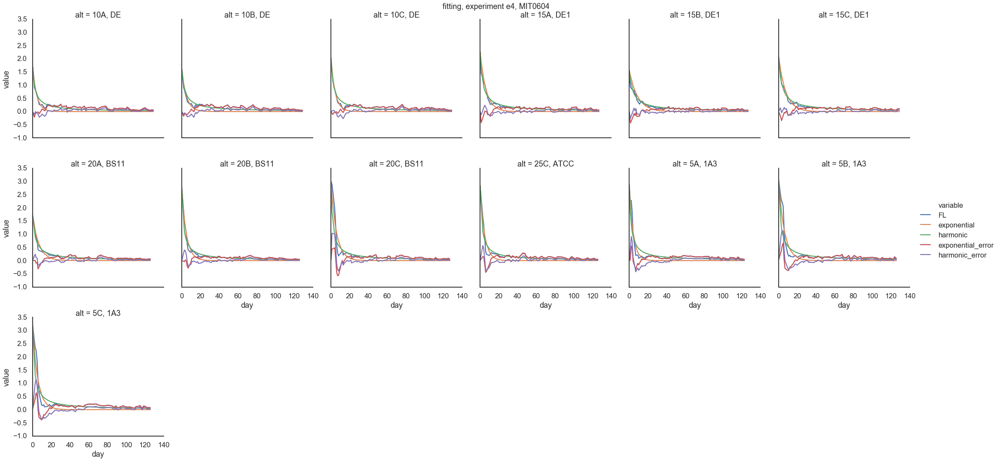

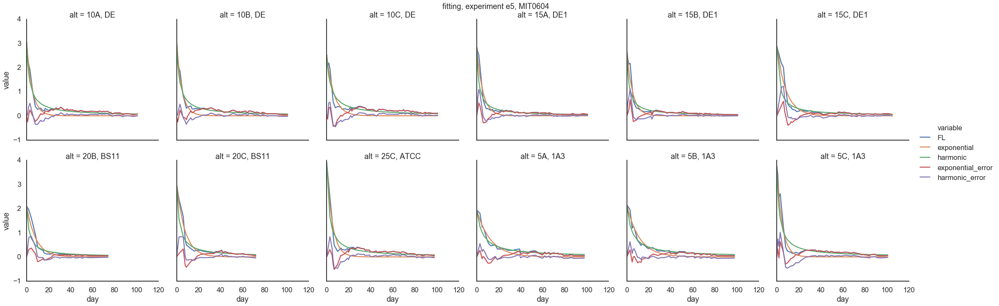

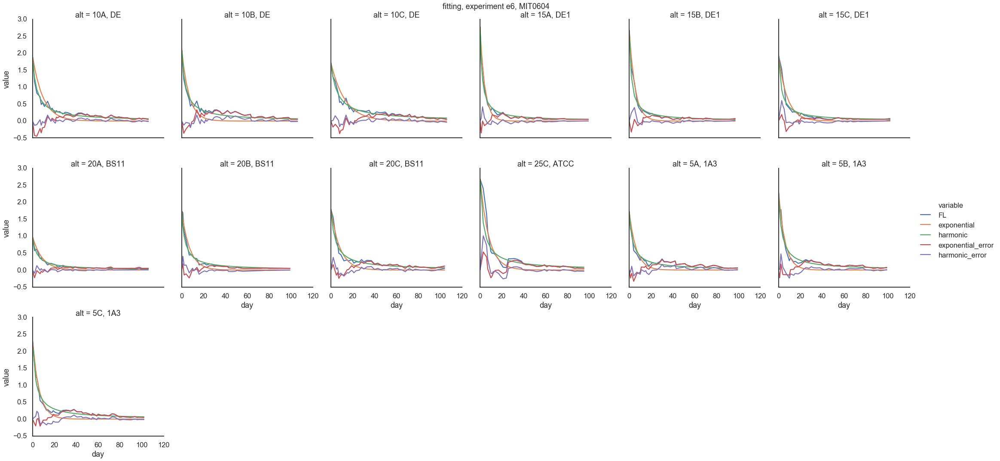

...

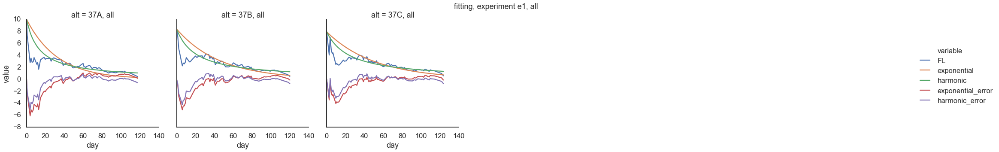

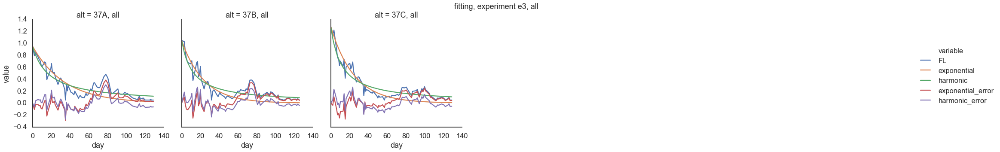

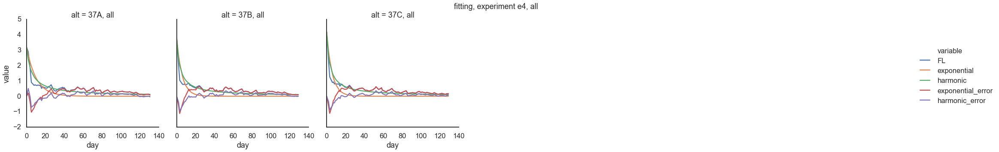

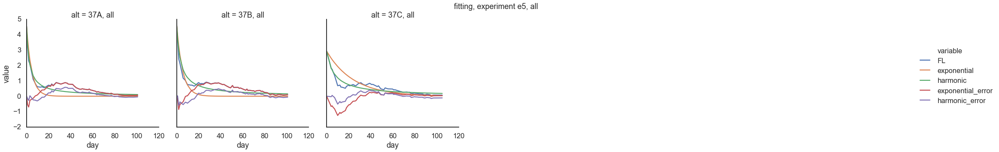

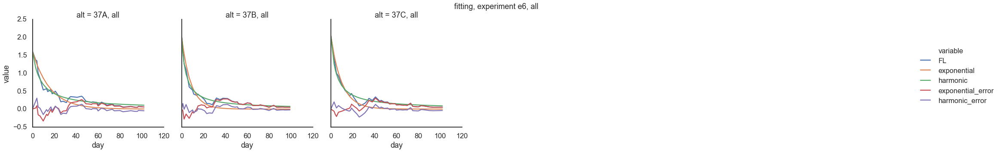

In [84]:
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
for p in dfresm.PRO.unique():
    for e in dfresm.experiment.unique():
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & (dfresm.PRO == p)], 
                x='day',
                y='value',
                hue='variable',
                col='alt',
                col_wrap=6,
                kind='line',
               )
        plt.suptitle(f'fitting, experiment {e}, {p}', y=1)
        plt.show()

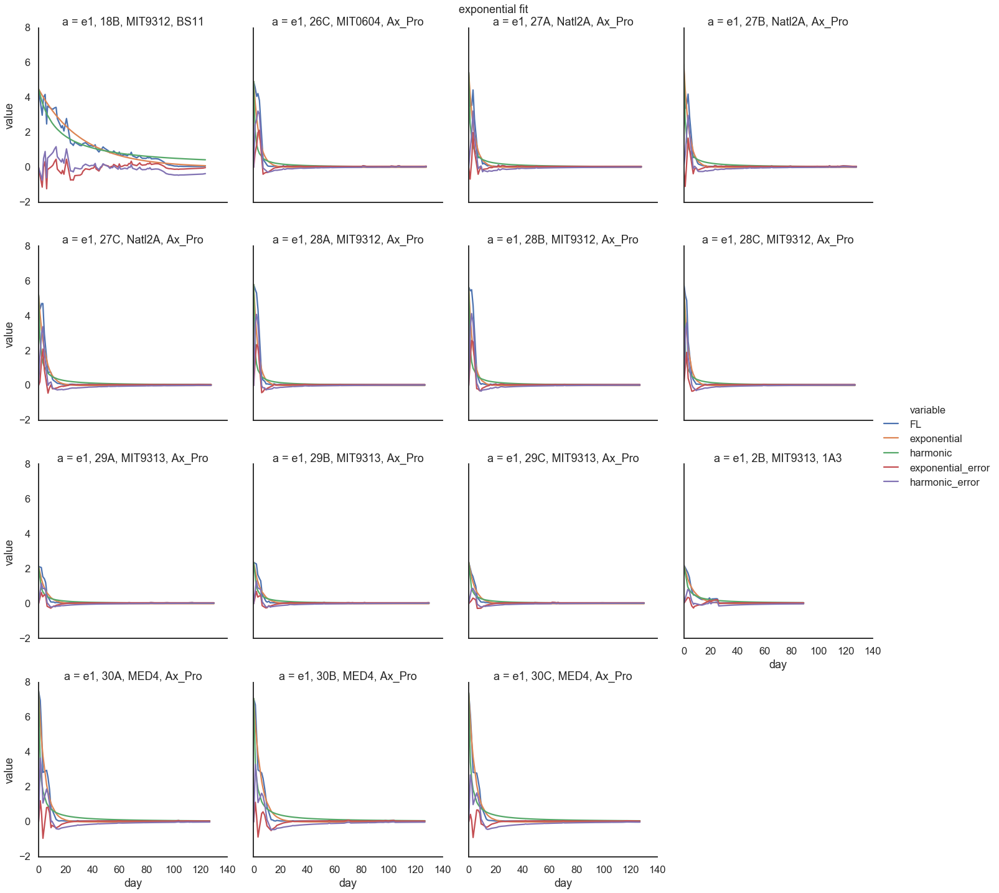

In [85]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
#    for e in dfresm.experiment.unique():
exponential_samples = best_model_df.loc[best_model_df.model == 'exponential', 'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'exponential fit', y=1)
plt.show()

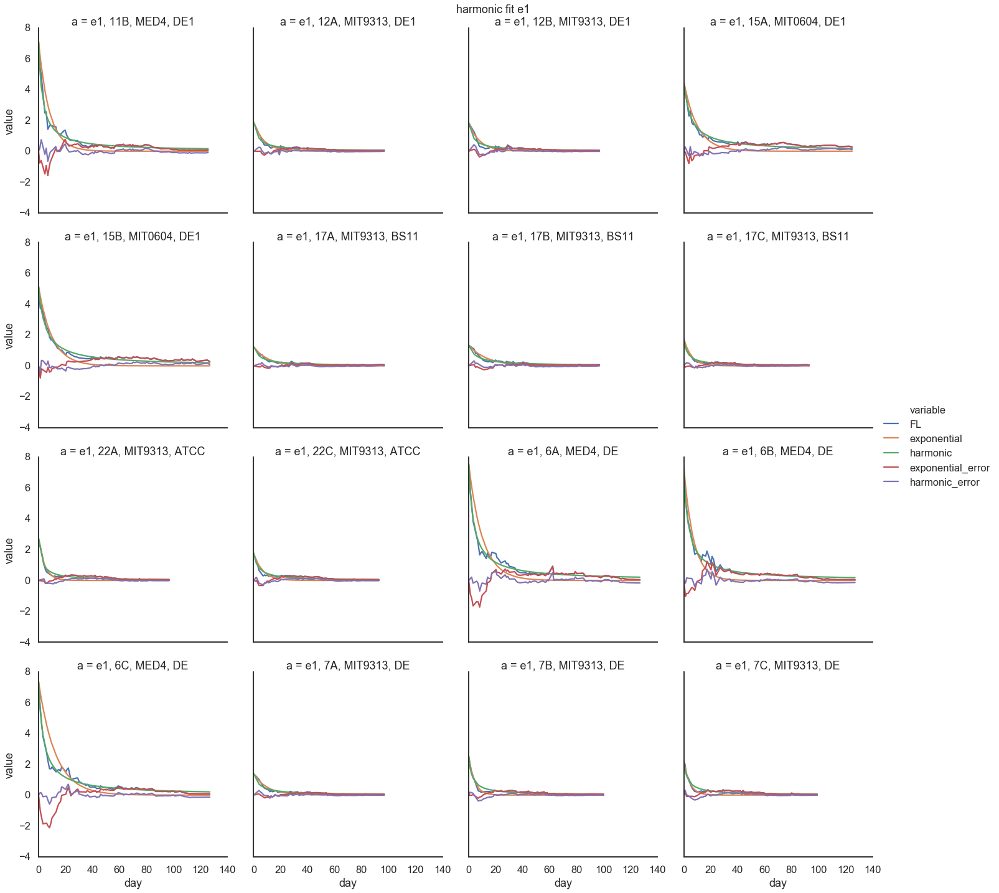

In [86]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[(best_model_df.model == 'harmonic') & (best_model_df.experiment == 'e1'),
                                        'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples[:16]) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'harmonic fit e1', y=1)
plt.show()

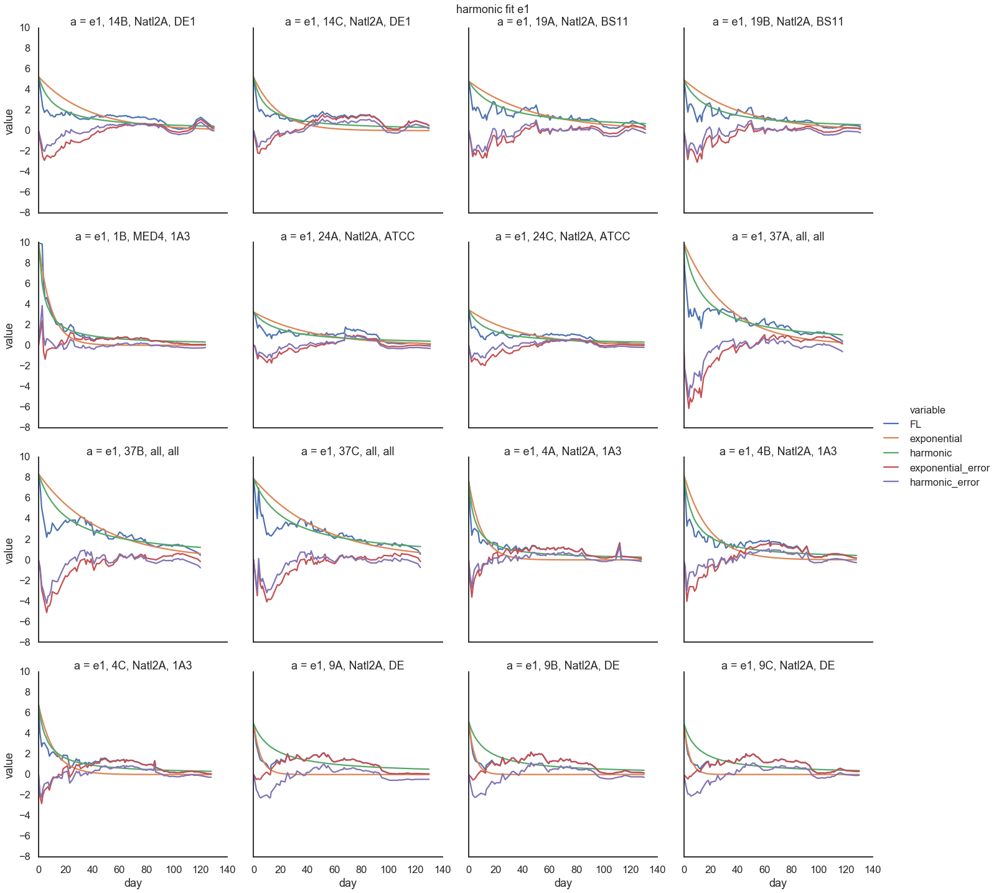

In [87]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[(best_model_df.model == 'harmonic') & (best_model_df.experiment == 'e1'),
                                        'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples[-16:]) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'harmonic fit e1', y=1)
plt.show()

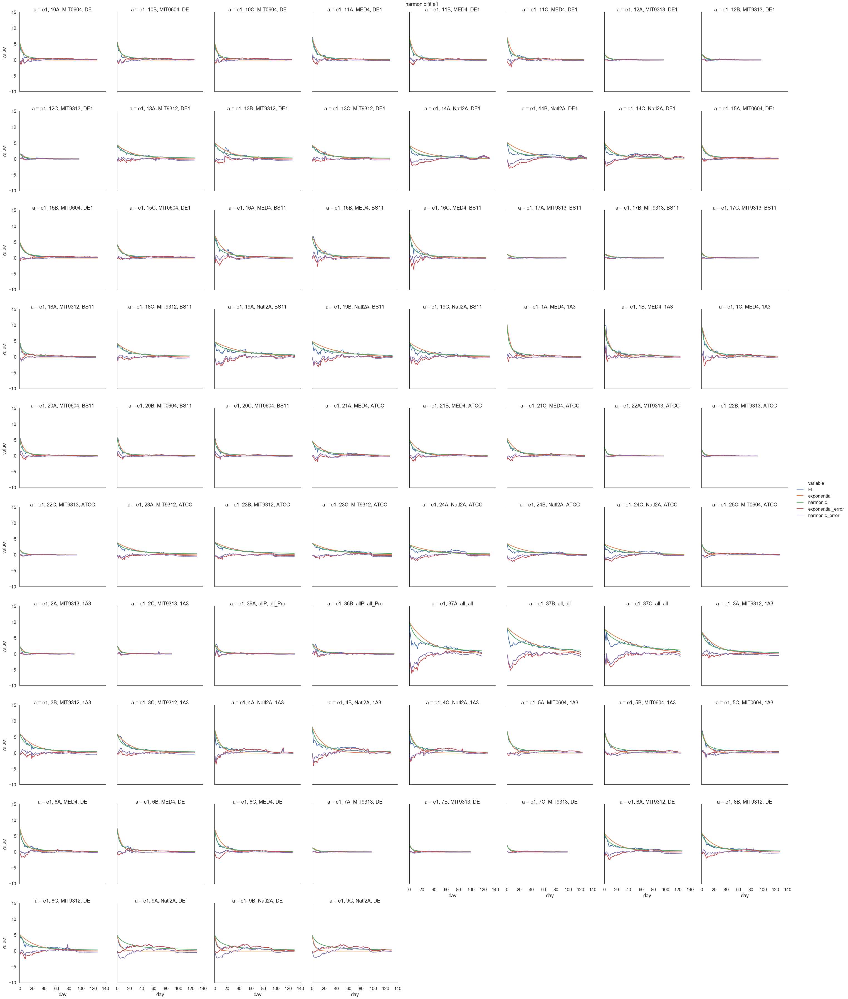

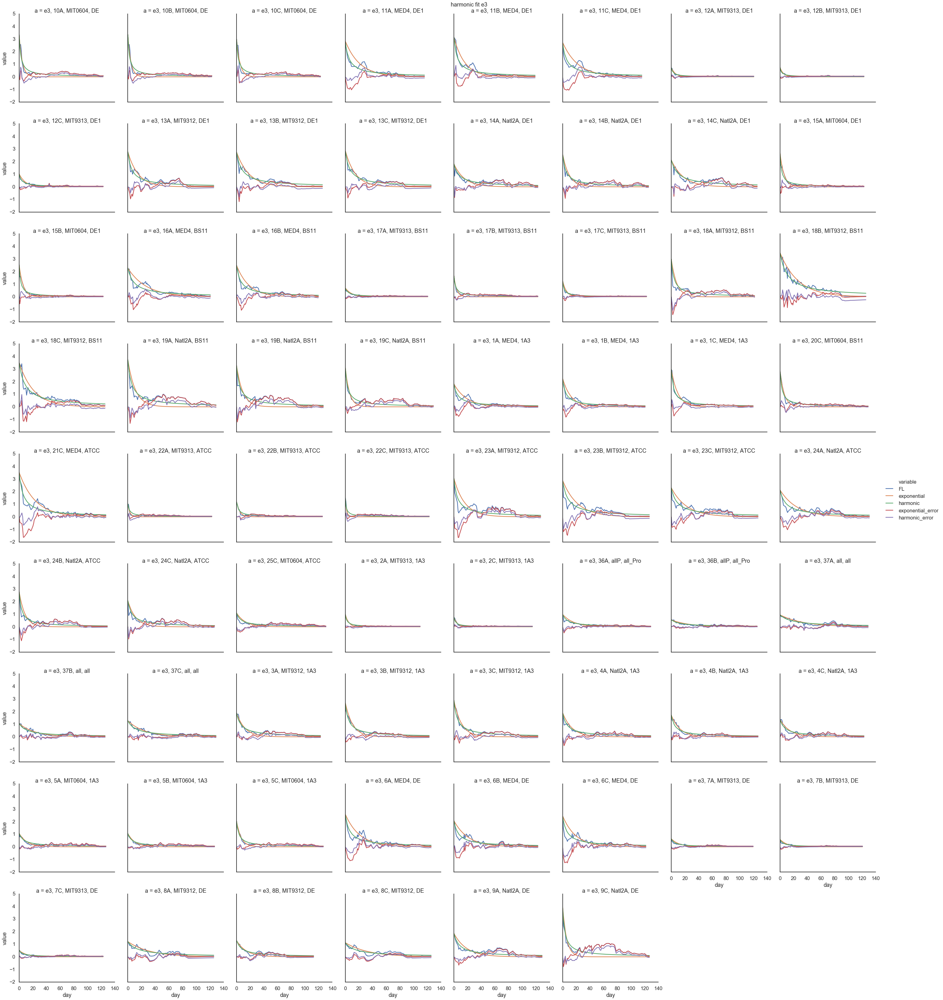

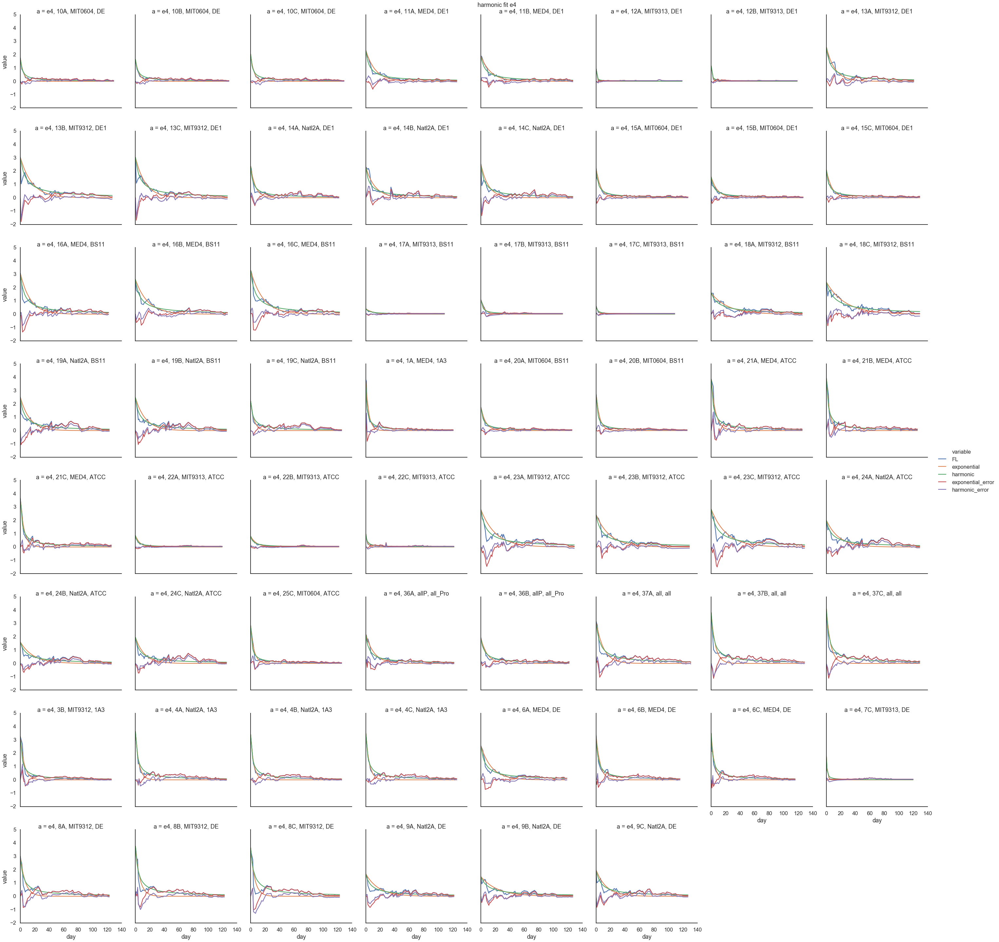

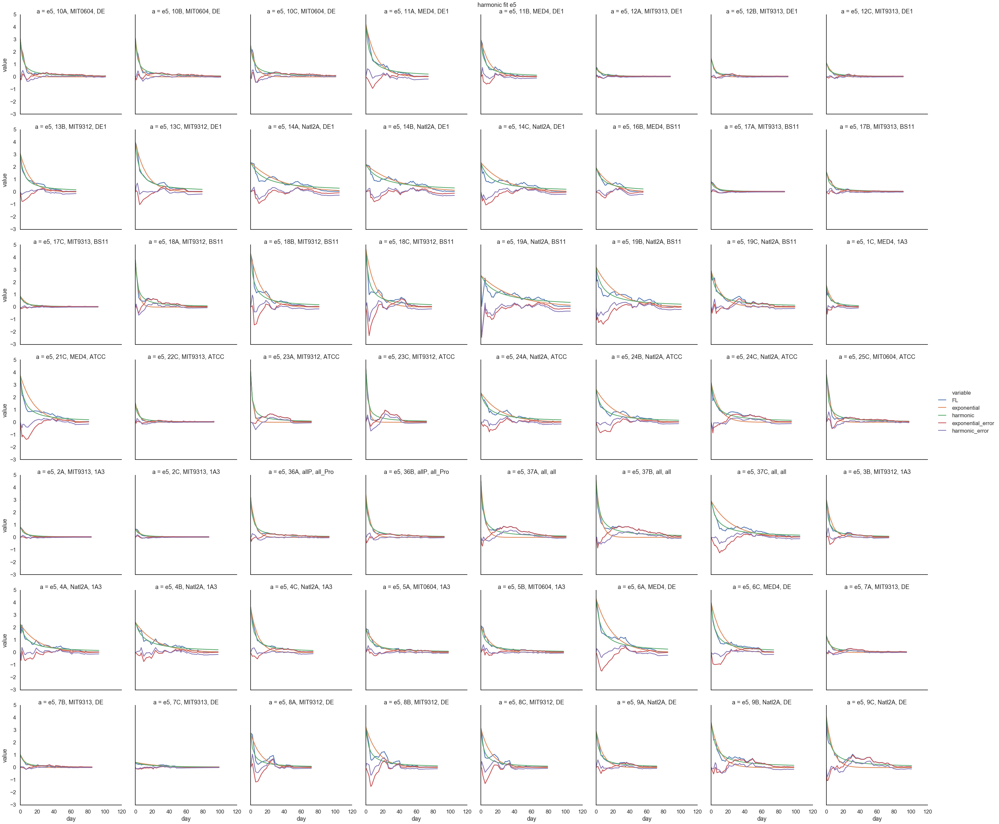

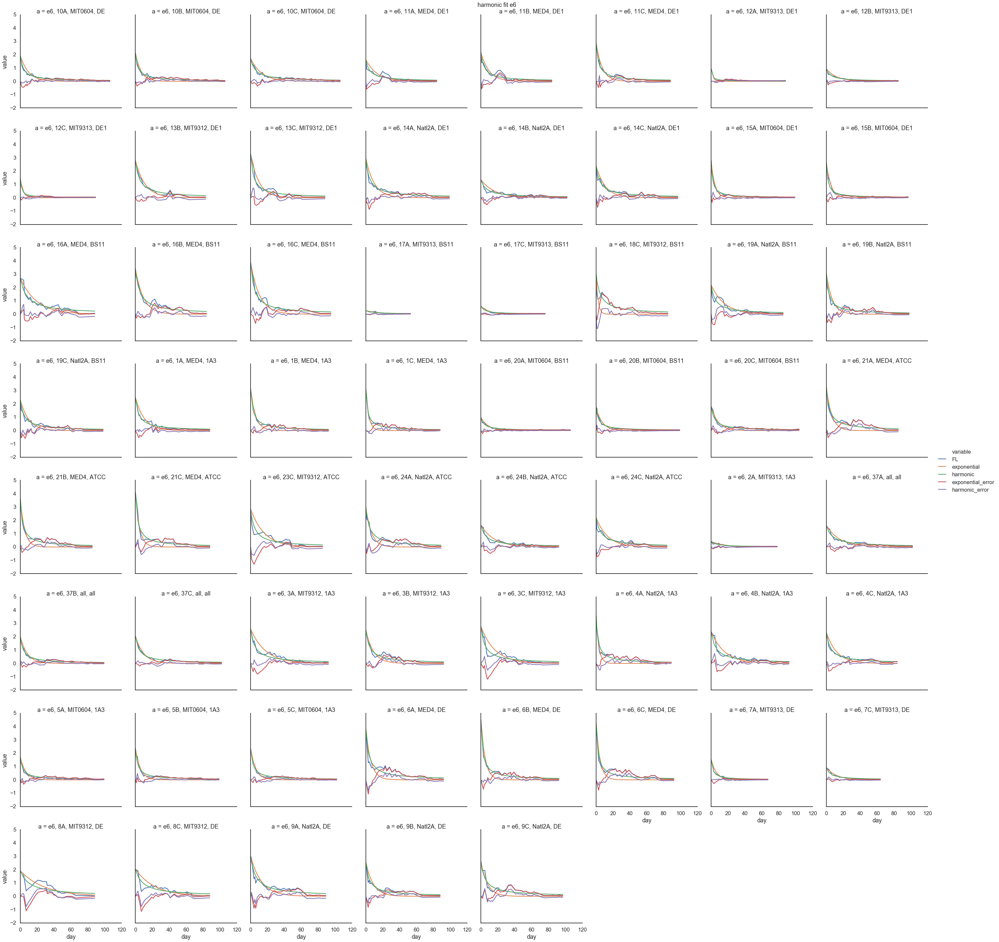

In [88]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[best_model_df.model == 'harmonic', 'experiment_sample']
for e in dfresm.experiment.unique():
    sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples) & 
                               (dfresm.experiment == e)
                               ], 
                    x='day',
                    y='value',
                    hue='variable',
                    col='a',
                    col_wrap=8,
                    kind='line',
                   )
    plt.suptitle(f'harmonic fit {e}', y=1)
    plt.show()

In [89]:
exponential_samples

2765    e3, 12B
2780    e3, 17C
2778    e3, 17A
2825     e3, 7B
2872    e4, 22B
         ...   
2755     e1, 9A
2756     e1, 9B
2736    e1, 37C
2735    e1, 37B
2734    e1, 37A
Name: experiment_sample, Length: 325, dtype: object

In [90]:
dfresm.columns

Index(['experiment_sample', 'day', 'experiment', 'sample', 'PRO', 'ALT',
       'culture', 'variable', 'value', 'alt', 'a'],
      dtype='object')